In [254]:
import pandas as pd
import sqlite3
import os
from pathlib import Path
from typing import Tuple, List, Any, Dict
import json
import os
import tqdm
import tiktoken
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.feature_extraction.text import CountVectorizer
import numpy as np
import sqlparse
from openai import OpenAI
import tqdm.notebook
import time
from dotenv import load_dotenv
import openai
import re
import matplotlib.pyplot as plt

In [255]:
file_path = f"din_sql_no_fields_4o_exec_match.csv"
base_path = f"/Users/chandreshmallick/Desktop/usc/fall24/spider_data/database"

In [52]:
load_dotenv()
openai.api_key = os.getenv("OPENAI_API_KEY")
client = OpenAI()

In [53]:
def GPT4_generation(system_prompt, user_prompt):
    response = client.chat.completions.create(
        model="gpt-4o-2024-11-20",
        messages=[
            {"role": "system", "content": system_prompt},
            {
                "role": "user", 
                "content": user_prompt
                }
            ],
        n = 1,
        stream = False,
        temperature=0.0,
        max_tokens=600,
        top_p = 1.0,
    )
    
    return response.choices[0].message.content

In [256]:
df = pd.read_csv(file_path)
df.head()

,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error
0,"Return the minimum, maximum, and average seati...",[track.Seating],"Table race, columns = [*,Race_ID,Name,Class,Da...",Foreign_keys = [race.Track_ID = track.Track_ID]\n,EASY,"SELECT MIN(track.Seating) AS min_seating, MAX(...","SELECT min(seating) , max(seating) , avg(sea...",race_track,1. Sequential Structure: Begin with the SELECT...,1.0,NaN
1,what are the first name and last name of all c...,"[People.first_name, People.last_name, Candidat...","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Students.student_id = People.p...,NON-NESTED,"SELECT People.first_name, People.last_name FRO...","SELECT T2.first_name , T2.last_name FROM cand...",student_assessment,1. Sequential Structure: Start with the SELECT...,1.0,NaN
2,What are the themes of farm competitions sorte...,"[farm_competition.Theme, farm_competition.Year]","Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT farm_competition.Theme, farm_competitio...",SELECT Theme FROM farm_competition ORDER BY YE...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN
3,"Return the different statuses of cities, ascen...",[city.Status],"Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT city.Status, COUNT(*) AS frequency FROM...",SELECT Status FROM city GROUP BY Status ORDER ...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN
4,What are the names of musicals who have no act...,"[musical.Name, actor.Musical_ID = musical.Musi...","Table actor, columns = [*,Actor_ID,Name,Musica...",Foreign_keys = [actor.Musical_ID = actor.Actor...,NESTED,SELECT musical.Name FROM musical WHERE musical...,SELECT Name FROM musical WHERE Musical_ID NOT ...,musical,1. Sequential Structure: Start with the SELECT...,1.0,NaN


In [5]:
df_erroneous_chains = df[df["score"]==0]
df_erroneous_chains.head()


,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error
2,What are the themes of farm competitions sorte...,"[farm_competition.Theme, farm_competition.Year]","Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT farm_competition.Theme, farm_competitio...",SELECT Theme FROM farm_competition ORDER BY YE...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN
3,"Return the different statuses of cities, ascen...",[city.Status],"Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT city.Status, COUNT(*) AS frequency FROM...",SELECT Status FROM city GROUP BY Status ORDER ...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN
8,How many male students (sex is 'M') are allerg...,"[Student.Sex, Student.StuID, Has_Allergy.StuID...","Table Allergy_Type, columns = [*,Allergy,Aller...",Foreign_keys = [Has_Allergy.Allergy = Allergy_...,NON-NESTED,SELECT COUNT(DISTINCT Student.StuID) FROM Stud...,"SELECT count(*) FROM Student WHERE sex = ""M""...",allergy_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN
10,Find the average millisecond length of Latin a...,"[Track.Milliseconds, Track.GenreId, Genre.Name...","Table Album, columns = [*,AlbumId,Title,Artist...",Foreign_keys = [Album.ArtistId = Artist.Artist...,NON-NESTED,"SELECT Genre.Name, AVG(Track.Milliseconds) AS ...",SELECT AVG(Milliseconds) FROM GENRE AS T1 JOIN...,chinook_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN
13,What are the names of all employees who are no...,"[employee.name,certificate.eid,certificate.aid...","Table aircraft, columns = [*,aid,name,distance...","Foreign_keys = [flight.aid = aircraft.aid,cert...",NESTED,SELECT employee.name FROM employee WHERE emplo...,SELECT name FROM Employee EXCEPT SELECT T1.nam...,flight_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN


In [257]:
def execute_query(query: str, db_path: str) -> Tuple[bool, List[Any], str]:
    """
    Execute a SQL query and return results
    
    Returns:
        Tuple containing:
        - Success boolean
        - Results list
        - Error message (if any)
    """
    try:
        conn = sqlite3.connect(db_path)
        cursor = conn.cursor()
        results = cursor.execute(query).fetchall()
        conn.close()
        return True, results, ""
    except Exception as e:
        return False, [], str(e)


In [258]:
def get_executions(df):
    # Ensure necessary columns exist in DataFrame for storing results and errors
    # df['pred_results'] = pd.Series([[]] * len(df), dtype="object")
    # df['gold_results'] = pd.Series([[]] * len(df), dtype="object")
    # df['pred_error'] = pd.Series([""] * len(df), dtype="object")
    # df['error_message'] = pd.Series([""] * len(df), dtype="object")
    

    # Iterate through DataFrame rows and execute queries
    for idx, row in df.iterrows():
        if not row['score']:
            db_path = f"{base_path}/{row['db_id']}/{row['db_id']}.sqlite"
            if not Path(db_path).exists():
                df.at[idx, 'error_message'] = f"Database not found: {row['db_id']}"
                continue

            # Execute the predicted and gold SQL queries
            pred_success, pred_results, pred_error = execute_query(row['predicted_sql'], db_path)
            gold_success, gold_results, gold_error = execute_query(row['gold_sql'], db_path)

            # Save the results and errors in the new columns
            df.at[idx, 'pred_results'] = str(pred_results)
            df.at[idx, 'gold_results'] = str(gold_results)
            df.at[idx, 'pred_error'] = pred_error

    return df

In [259]:
full_df = get_executions(df)

In [9]:
full_df.head()

,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error
0,"Return the minimum, maximum, and average seati...",[track.Seating],"Table race, columns = [*,Race_ID,Name,Class,Da...",Foreign_keys = [race.Track_ID = track.Track_ID]\n,EASY,"SELECT MIN(track.Seating) AS min_seating, MAX(...","SELECT min(seating) , max(seating) , avg(sea...",race_track,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,NaN,NaN,NaN
1,what are the first name and last name of all c...,"[People.first_name, People.last_name, Candidat...","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Students.student_id = People.p...,NON-NESTED,"SELECT People.first_name, People.last_name FRO...","SELECT T2.first_name , T2.last_name FROM cand...",student_assessment,1. Sequential Structure: Start with the SELECT...,1.0,NaN,NaN,NaN,NaN
2,What are the themes of farm competitions sorte...,"[farm_competition.Theme, farm_competition.Year]","Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT farm_competition.Theme, farm_competitio...",SELECT Theme FROM farm_competition ORDER BY YE...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[('Aliens', 2002), ('MTV Cube', 2003), (""Valen...","[('Aliens',), ('MTV Cube',), (""Valentine's Day...",
3,"Return the different statuses of cities, ascen...",[city.Status],"Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT city.Status, COUNT(*) AS frequency FROM...",SELECT Status FROM city GROUP BY Status ORDER ...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[('Town', 1), ('Village', 4)]","[('Town',), ('Village',)]",
4,What are the names of musicals who have no act...,"[musical.Name, actor.Musical_ID = musical.Musi...","Table actor, columns = [*,Actor_ID,Name,Musica...",Foreign_keys = [actor.Musical_ID = actor.Actor...,NESTED,SELECT musical.Name FROM musical WHERE musical...,SELECT Name FROM musical WHERE Musical_ID NOT ...,musical,1. Sequential Structure: Start with the SELECT...,1.0,NaN,NaN,NaN,NaN


In [18]:
full_df['exec_match_error'].unique()

array([nan,
       'gold query SELECT T1.company_name FROM Third_Party_Companies AS T1 JOIN Maintenance_Contracts AS T2 ON T1.company_id  =  T2.maintenance_contract_company_id JOIN Ref_Company_Types AS T3 ON T1.company_type_code  =  T3.company_type_code ORDER BY T2.contract_end_date DESC LIMIT 1 has error on database file /Users/chandreshmallick/Desktop/usc/fall24/spider_data/database/assets_maintenance/assets_maintenance.sqlite',
       'gold query SELECT document_name FROM documents GROUP BY document_type_code ORDER BY count(*) DESC LIMIT 3 INTERSECT SELECT document_name FROM documents GROUP BY document_structure_code ORDER BY count(*) DESC LIMIT 3 has error on database file /Users/chandreshmallick/Desktop/usc/fall24/spider_data/database/document_management/document_management.sqlite'],
      dtype=object)

In [30]:
full_df[(full_df.score==0) & (full_df['pred_error']!="")][["question", "schema_links", "foriegn keys", "predicted_sql", "gold_sql", "pred_error"]].to_csv(f"evaluate_schema.csv")

In [31]:
full_df[(full_df.score == 0) & (full_df.pred_error != "")]


,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error
276,What are the names of all playlists that have ...,"[playlists.name, playlist_tracks.playlist_id, ...","Table albums, columns = [*,id,title,artist_id]...","Foreign_keys = [albums.artist_id = artists.id,...",NON-NESTED,SELECT playlists.name FROM playlists JOIN play...,SELECT T2.name FROM playlist_tracks AS T1 JOIN...,store_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,[],"[('Music',), ('TV Shows',), ('90’s Music',), (...",no such column: playlists.playlist_id
345,List the name of playlist which has number of ...,"[playlists.name,playlist_tracks.playlist_id,pl...","Table albums, columns = [*,id,title,artist_id]...","Foreign_keys = [albums.artist_id = artists.id,...",NON-NESTED,SELECT playlists.name FROM playlists JOIN play...,SELECT T2.name FROM playlist_tracks AS T1 JOIN...,store_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,[],"[('Music',), ('TV Shows',), ('90’s Music',), (...",no such column: playlists.playlist_id
402,What zip codes have a station with a max tempe...,"[station.zip_code, weather.date, weather.max_t...","Table station, columns = [*,id,name,lat,long,d...",Foreign_keys = [status.station_id = station.id]\n,NON-NESTED,"SELECT station.zip_code, weather.date FROM sta...","SELECT date , zip_code FROM weather WHERE max...",bike_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,[],"[('9/6/2013', 94107), ('9/7/2013', 94107), ('9...",no such column: station.zip_code
555,Find the name of tracks which are in both Movi...,"[tracks.name,playlist_tracks.track_id,playlist...","Table albums, columns = [*,id,title,artist_id]...","Foreign_keys = [albums.artist_id = artists.id,...",NESTED,SELECT DISTINCT tracks.name FROM tracks JOIN p...,SELECT T1.name FROM tracks AS T1 JOIN playlist...,store_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,[],[],no such column: tracks.track_id
706,What are the names of all tracks that are on p...,"[tracks.name, playlists.title, playlist_tracks...","Table albums, columns = [*,id,title,artist_id]...","Foreign_keys = [albums.artist_id = artists.id,...",NON-NESTED,SELECT tracks.name FROM playlist_tracks JOIN t...,SELECT T1.name FROM tracks AS T1 JOIN playlist...,store_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,[],[],no such column: playlists.title
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6378,Find the country of all appelations who have a...,"[appellations.County, wine.Appelation, wine.No...","Table appellations, columns = [*,No,Appelation...",Foreign_keys = [wine.Appelation = appellations...,NESTED,SELECT appellations.Country FROM appellations ...,SELECT T1.County FROM APPELLATIONS AS T1 JOIN ...,wine_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,[],"[('N/A',), ('Mendocino',), ('San Luis Obispo',...",no such column: appellations.Country
6388,"What are the country names, area and populatio...","[country.Name, country.Area, country.Populatio...","Table country, columns = [*,Country_ID,Name,Po...",Foreign_keys = [roller_coaster.Country_ID = co...,NESTED,"SELECT country.Name, country.Area, country.Pop...","SELECT T1.name , T1.area , T1.population FRO...",roller_coaster,1. Sequential Structure: Start with the SELECT...,0.0,NaN,[],"[('Austria', 83871, 8206524)]",no such column: specific_value
6393,What are the names of wines that are more expe...,"[wine.Name, wine.Price, wine.Year]","Table appellations, columns = [*,No,Appelation...",Foreign_keys = [wine.Appelation = appellations...,NESTED,SELECT wine.Name FROM wine WHERE wine.Price > ...,SELECT Name FROM WINE WHERE Price > (SELECT ...,wine_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,[],"[('Darius II',)]","near ""ALL"": syntax error"
6493,Find the distinct names of all wines that have...,"[wine.Name, wine.Price, wine.Winery, John Anth...","Table appellations, columns = [*,No,Appelation.

In [132]:
full_df[(full_df.score == 0) & (full_df.classification == "NESTED")]


,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error
10,Find all the customer last names that do not h...,"[Customer.LastName, Invoice.Total, Invoice.Cus...","Table Album, columns = [*,AlbumId,Title,Artist...",Foreign_keys = [Album.ArtistId = Artist.Artist...,NESTED,SELECT DISTINCT Customer.LastName FROM Custome...,SELECT LastName FROM CUSTOMER EXCEPT SELECT T1...,chinook_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Köhler',), ('Hansen',), ('Peeters',), ('Phi...","[('Almeida',), ('Barnett',), ('Bernard',), ('B...",
24,Find the policy types more than 4 customers us...,"[AvailablePolicies.policytypecode, CustomersPo...","Table Available_Policies, columns = [*,Policy_...",Foreign_keys = [Customers_Policies.Policy_ID =...,NESTED,SELECT Available_Policies.policy_type_code FRO...,SELECT policy_type_code FROM available_policie...,insurance_fnol,1. Sequential Structure: Start with the SELECT...,0.0,NaN,[],"[('Mortgage Insurance',), ('Property Insurance...",
28,How many students have each different allergy?,"[HasAllergy.StuID, HasAllergy.Allergy, Allergy...","Table Allergy_Type, columns = [*,Allergy,Aller...",Foreign_keys = [Has_Allergy.Allergy = Allergy_...,NESTED,"SELECT AllergyType.Allergy, COUNT(Has_Allergy....","SELECT Allergy , count(*) FROM Has_allergy GR...",allergy_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,[],"[('Anchovies', 3), ('Cat', 4), ('Dog', 3), ('E...",no such column: AllergyType.Allergy
46,Find the total number of students enrolled in ...,"[university.SchoolID, university.Founded, univ...","Table basketball_match, columns = [*,Team_ID,S...",Foreign_keys = [basketball_match.School_ID = u...,NESTED,"SELECT university.Affiliation, SUM(university....","SELECT sum(Enrollment) , affiliation FROM uni...",university_basketball,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Private/Methodist', 2100.0), ('Public', 239...","[(2100.0, 'Private/Methodist'), (43092.0, 'Pub...",
47,Show the name of colleges that have at least t...,"[team.Name, player.Team, player.Team = team.Te...","Table country, columns = [*,Country_id,Country...",Foreign_keys = [match_season.Team = team.Team_...,NESTED,SELECT team.Name FROM player JOIN team ON play...,SELECT College FROM match_season GROUP BY Coll...,match_season,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Columbus Crew',)]","[('Maryland',), ('UCLA',), ('Virginia',)]",
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6984,Which countries has the most number of airline...,"[airlines.country, airlines.active, airlines.a...","Table airlines, columns = [*,alid,name,iata,ic...","Foreign_keys = [routes.alid = airlines.alid,ro...",NESTED,"SELECT country, COUNT(*) AS airline_count FROM...",SELECT country FROM airlines WHERE active = ...,flight_4,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('United States', 156)]","[('United States',)]",
6987,What are the distinct last names of the studen...,"[Student.LName, Votingrecord.PresidentVote, St...","Table Student, columns = [*,StuID,LName,Fname,...",Foreign_keys = [Voting_record.Class_Senator_Vo...,NESTED,SELECT DISTINCT Student.LName FROM Student JOI...,SELECT DISTINCT T1.LName FROM STUDENT AS T1 JO...,voter_2,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Smith',), ('Kim',), ('Jones',), ('Kumar',),...","[('Kumar',), ('Norris',), ('Prater',)]",
6991,What is the last name of the staff who has han...,"[Staff.lastname, Complaints.complaintid, Compl...","Table Complaints, columns = [*,complaint_id,pr...",Foreign_keys = [Complaints.customer_id = Custo...,NESTED,SELECT Staff.last_name FROM Complaints JOIN St...,SELECT t1.last_name FROM staff AS t1 JOIN comp...,customer_complaints,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Boehm',)]","[('Lynch',)]",
6995,Find the distinct names of all wines that have...,"[wine.Name, wine.Price, wine.Win

In [133]:
full_df.to_csv("chains_eval_result_4o_mini_full_train.csv", index=False)

In [134]:
full_df[(full_df.score == 0) & (full_df.pred_error == "") & (df.classification == "NESTED")]


,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error
10,Find all the customer last names that do not h...,"[Customer.LastName, Invoice.Total, Invoice.Cus...","Table Album, columns = [*,AlbumId,Title,Artist...",Foreign_keys = [Album.ArtistId = Artist.Artist...,NESTED,SELECT DISTINCT Customer.LastName FROM Custome...,SELECT LastName FROM CUSTOMER EXCEPT SELECT T1...,chinook_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Köhler',), ('Hansen',), ('Peeters',), ('Phi...","[('Almeida',), ('Barnett',), ('Bernard',), ('B...",
24,Find the policy types more than 4 customers us...,"[AvailablePolicies.policytypecode, CustomersPo...","Table Available_Policies, columns = [*,Policy_...",Foreign_keys = [Customers_Policies.Policy_ID =...,NESTED,SELECT Available_Policies.policy_type_code FRO...,SELECT policy_type_code FROM available_policie...,insurance_fnol,1. Sequential Structure: Start with the SELECT...,0.0,NaN,[],"[('Mortgage Insurance',), ('Property Insurance...",
46,Find the total number of students enrolled in ...,"[university.SchoolID, university.Founded, univ...","Table basketball_match, columns = [*,Team_ID,S...",Foreign_keys = [basketball_match.School_ID = u...,NESTED,"SELECT university.Affiliation, SUM(university....","SELECT sum(Enrollment) , affiliation FROM uni...",university_basketball,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Private/Methodist', 2100.0), ('Public', 239...","[(2100.0, 'Private/Methodist'), (43092.0, 'Pub...",
47,Show the name of colleges that have at least t...,"[team.Name, player.Team, player.Team = team.Te...","Table country, columns = [*,Country_id,Country...",Foreign_keys = [match_season.Team = team.Team_...,NESTED,SELECT team.Name FROM player JOIN team ON play...,SELECT College FROM match_season GROUP BY Coll...,match_season,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Columbus Crew',)]","[('Maryland',), ('UCLA',), ('Virginia',)]",
48,Which address do not have any member with the ...,"[shop.Address, member.Membershipcard, member.M...","Table happy_hour, columns = [*,HH_ID,Shop_ID,M...",Foreign_keys = [happy_hour.Shop_ID = shop.Shop...,NESTED,SELECT shop.Address FROM shop LEFT JOIN happy_...,SELECT address FROM member EXCEPT SELECT addre...,coffee_shop,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('1100 Main Street',), ('1111 Main Street',),...","[('Cheshire',)]",
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6984,Which countries has the most number of airline...,"[airlines.country, airlines.active, airlines.a...","Table airlines, columns = [*,alid,name,iata,ic...","Foreign_keys = [routes.alid = airlines.alid,ro...",NESTED,"SELECT country, COUNT(*) AS airline_count FROM...",SELECT country FROM airlines WHERE active = ...,flight_4,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('United States', 156)]","[('United States',)]",
6987,What are the distinct last names of the studen...,"[Student.LName, Votingrecord.PresidentVote, St...","Table Student, columns = [*,StuID,LName,Fname,...",Foreign_keys = [Voting_record.Class_Senator_Vo...,NESTED,SELECT DISTINCT Student.LName FROM Student JOI...,SELECT DISTINCT T1.LName FROM STUDENT AS T1 JO...,voter_2,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Smith',), ('Kim',), ('Jones',), ('Kumar',),...","[('Kumar',), ('Norris',), ('Prater',)]",
6991,What is the last name of the staff who has han...,"[Staff.lastname, Complaints.complaintid, Compl...","Table Complaints, columns = [*,complaint_id,pr...",Foreign_keys = [Complaints.customer_id = Custo...,NESTED,SELECT Staff.last_name FROM Complaints JOIN St...,SELECT t1.last_name FROM staff AS t1 JOIN comp...,customer_complaints,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Boehm',)]","[('Lynch',)]",
6995,Find the distinct names of all wines that have...,"[wine.Name, wine.Price, wine.Winery, 'John Ant..."

In [105]:
IGNORE_PROMPT = f"""### Example 2
#### User input
Database schema:
fields: Table Addresses, columns = [*,address_id,line_1,line_2,city,zip_postcode,state_province_county,country]
Table Candidate_Assessments, columns = [*,candidate_id,qualification,assessment_date,asessment_outcome_code]
Table Candidates, columns = [*,candidate_id,candidate_details]
Table Courses, columns = [*,course_id,course_name,course_description,other_details]
Table People, columns = [*,person_id,first_name,middle_name,last_name,cell_mobile_number,email_address,login_name,password]
Table People_Addresses, columns = [*,person_address_id,person_id,address_id,date_from,date_to]
Table Student_Course_Attendance, columns = [*,student_id,course_id,date_of_attendance]
Table Student_Course_Registrations, columns = [*,student_id,course_id,registration_date]
Table Students, columns = [*,student_id,student_details]

foreign keys: Foreign_keys = [Students.student_id = People.person_id,People_Addresses.address_id = Addresses.address_id,People_Addresses.person_id = People.person_id,Student_Course_Registrations.course_id = Courses.course_id,Student_Course_Registrations.student_id = Students.student_id,Student_Course_Attendance.student_id = Student_Course_Registrations.student_id,Student_Course_Attendance.course_id = Student_Course_Registrations.course_id,Candidates.candidate_id = People.person_id,Candidate_Assessments.candidate_id = Candidates.candidate_id]

User question:
What are the details of the student who registered for the most number of courses?

Schema_links:
[Students.studentid, Students.studentdetails, StudentCourseRegistrations.studentid = Students.studentid]

Reasoning chains:
1. Sequential Structure: Start with the SELECT clause to retrieve the details of the student. Use the FROM clause to specify the Students table. We will also need to join the Student_Course_Registrations table to count the number of courses each student has registered for. 2. Join Structure: Use an INNER JOIN between the Students table and the Student_Course_Registrations table based on the student_id to link students with their course registrations. 3. Aggregation Structure: Use GROUP BY to group the results by student_id, allowing us to count the number of courses each student has registered for. We will use the COUNT function to get the total number of registrations per student. 4. Condition Structure: Use the HAVING clause to filter for the student(s) with the maximum number of course registrations. This can be achieved by using a subquery to find the maximum count of registrations.

Generated SQL query based on reasoning chains:
SELECT Students.* FROM Students JOIN Student_Course_Registrations ON Students.student_id = Student_Course_Registrations.student_id GROUP BY Students.student_id HAVING COUNT(Student_Course_Registrations.course_id) = (SELECT MAX(course_count) FROM (SELECT COUNT(course_id) AS course_count FROM Student_Course_Registrations GROUP BY student_id) AS counts);

Execution results of generated SQL query:
[(121, 'Martin'), (141, 'Nikhil')]

Ground truth SQL:
SELECT T1.student_details FROM students AS T1 JOIN student_course_registrations AS T2 ON T1.student_id = T2.student_id GROUP BY T1.student_id ORDER BY count(*) DESC LIMIT 1

Execution results of ground truth SQL:
[('Martin',)]

#### Example 2 output
<critique>
Sequential Structure:
The reasoning chain starts with the correct intention by focusing on retrieving details of students from the `Students` table, joining with `Student_Course_Registrations` to determine the count of course registrations. However, the reasoning chain does not specify that only `student_details` should be selected, resulting in ambiguity and the retrieval of additional, unnecessary columns in the final query. Additionally, it does not specify ordering the result by the count of registrations, which is crucial to identify the student with the most course registrations effectively.

Condition Structure:
The reasoning chain intends to filter for the student with the maximum course registrations using the HAVING clause. However, the reasoning chain’s proposed solution of using a subquery to find the maximum count introduces complexity and can lead to unintended results. The correct approach would involve a straightforward `ORDER BY` clause, combined with `LIMIT 1`, to simplify and correctly identify the student with the highest number of course registrations.

Join Structure:
The reasoning chain correctly identifies the need to join the `Students` and `Student_Course_Registrations` tables on `student_id` to access course registration data for each student. This join is essential for counting registrations, and the chain’s description of this step is accurate and well-structured.

Aggregation Structure:
The reasoning chain correctly proposes using `GROUP BY` with `COUNT` to get the total number of registrations per student. However, it overcomplicates the aggregation by using a subquery to calculate the maximum count, rather than ordering by the count directly. This misstep results in multiple rows instead of the expected single row for the top student. A more effective aggregation approach would be to sort by the count and apply a `LIMIT 1` clause to select only the student with the highest count of registrations.
</critique>

### Example 3
#### User input
Database schema:
fields: Table city, columns = [*,City_ID,Official_Name,Status,Area_km_2,Population,Census_Ranking]
Table competition_record, columns = [*,Competition_ID,Farm_ID,Rank]
Table farm, columns = [*,Farm_ID,Year,Total_Horses,Working_Horses,Total_Cattle,Oxen,Bulls,Cows,Pigs,Sheep_and_Goats]
Table farm_competition, columns = [*,Competition_ID,Year,Theme,Host_city_ID,Hosts]

foreign keys: Foreign_keys = [farm_competition.Host_city_ID = city.City_ID,competition_record.Farm_ID = farm.Farm_ID,competition_record.Competition_ID = farm_competition.Competition_ID]

User question:
Which statuses correspond to both cities that have a population over 1500 and cities that have a population lower than 500?

Schema_links:
[city.Status, city.Population, 1500, 500]

Reasoning chains:
1. Sequential Structure: Start with the SELECT clause to retrieve the "Status" field from the "city" table. 2. Condition Structure: Use a WHERE clause to filter cities based on their population, specifically those with a population greater than 1500 and those with a population less than 500. 3. Join Structure: Not required, as we are only querying the city table. 4. Aggregation Structure: Use a UNION to combine the results of two separate queries: one for cities with a population over 1500 and another for cities with a population under 500. This will allow us to find statuses that correspond to both conditions.

Generated SQL query based on reasoning chains:
SELECT Status FROM city WHERE Population > 1500 UNION SELECT Status FROM city WHERE Population < 500;

Execution results of generated SQL query:
[('Town',), ('Village',)]

Ground truth SQL:
SELECT Status FROM city WHERE Population  >  1500 INTERSECT SELECT Status FROM city WHERE Population  <  500

Execution results of ground truth SQL:
[('Village',)]

#### Example 3 output
<critique>
Sequential Structure:
The reasoning chain correctly starts with the intent to select the "Status" field from the "city" table. However, it does not specify the requirement to identify statuses that correspond to cities satisfying both conditions (population over 1500 and under 500), which directly impacts the SQL structure chosen. This omission leads to the use of an incorrect UNION operation rather than an INTERSECT, which is required to find statuses common to both populations.

Condition Structure:
The reasoning chain specifies using a WHERE clause to filter cities based on population. This is correct in identifying the two conditions: cities with populations greater than 1500 and cities with populations less than 500. However, it fails to emphasize the need to find "Status" values that satisfy both conditions simultaneously, resulting in a UNION operation instead of an INTERSECT. This misinterpretation of the filtering requirement is a significant error, as it changes the result set from a shared subset to a combined set.

Join Structure:
The reasoning chain correctly identifies that no joins are required for this query, as all necessary data is available within the "city" table. This is appropriate given the query structure and dataset.

Aggregation Structure:
The reasoning chain incorrectly suggests using a UNION to combine the results of two separate queries, one for each population condition. This approach does not achieve the desired outcome of identifying statuses that meet both population conditions. Instead, an INTERSECT operation should be used to find statuses that exist in both subsets (over 1500 and under 500). This misunderstanding of the aggregation structure is a critical flaw, as it directly leads to the wrong SQL output and fails to meet the query requirements.
</critique>

### Example 4
#### User input
Database schema:
fields: Table station, columns = [*,id,name,lat,long,dock_count,city,installation_date] 
Table status, columns = [*,station_id,bikes_available,docks_available,time]
Table trip, columns = [*,id,duration,start_date,start_station_name,start_station_id,end_date,end_station_name,end_station_id,bike_id,subscription_type,zip_code]
Table weather, columns = [*,date,max_temperature_f,mean_temperature_f,min_temperature_f,max_dew_point_f,mean_dew_point_f,min_dew_point_f,max_humidity,mean_humidity,min_humidity,max_sea_level_pressure_inches,mean_sea_level_pressure_inches,min_sea_level_pressure_inches,max_visibility_miles,mean_visibility_miles,min_visibility_miles,max_wind_Speed_mph,mean_wind_speed_mph,max_gust_speed_mph,precipitation_inches,cloud_cover,events,wind_dir_degrees,zip_code]

foreign keys: Foreign_keys = [status.station_id = station.id]

User question:
How many trips did not end in San Francisco?

Schema_links:
[trip.endstationname, 'San Francisco']

Reasoning chains:
1. Sequential Structure: Start with the SELECT clause to count the number of trips. Use the FROM clause to specify the trip table. 2. Condition Structure: Apply a WHERE clause to filter trips that did not end in 'San Francisco'. 3. Join Structure: Not required, as all necessary data is available within the trip table. 4. Aggregation Structure: Use the COUNT function to aggregate the total number of trips that meet the specified condition.

Generated SQL query based on reasoning chains:
SELECT COUNT(*) FROM trip WHERE end_station_name <> 'San Francisco';

Execution results of generated SQL query:
[(9959,)]

Ground truth SQL:
SELECT count(*) FROM trip AS T1 JOIN station AS T2 ON T1.end_station_id  =  T2.id WHERE T2.city != "San Francisco"

Execution results of ground truth SQL:
[(999,)]

#### Example 4 output
<critique>
Sequential Structure:
The reasoning chain begins with the correct intent by specifying the SELECT clause to count the number of trips and using the FROM clause to reference the `trip` table. However, it fails to account for the need to join with the `station` table to correctly determine the city associated with the `end_station_id`. This oversight leads to an inaccurate query structure, as it does not allow for proper filtering based on the city associated with each trip’s end station.

Condition Structure:
The reasoning chain proposes a WHERE clause to filter for trips that did not end in 'San Francisco' by directly checking `end_station_name`. This is incorrect because the city name is not explicitly stored in the `trip` table, and the `end_station_name` does not necessarily provide city information. The correct approach requires filtering based on the city field in the `station` table by joining `trip` with `station` on `end_station_id`. This crucial step is missing, leading to incorrect filtering.

Join Structure:
The reasoning chain incorrectly concludes that no join is necessary, assuming all relevant data is in the `trip` table. In reality, a join with the `station` table is required to access the `city` attribute, allowing the query to filter based on trips that ended in a city other than San Francisco. This oversight in the join structure is a fundamental flaw in the reasoning chain, as it prevents accurate identification of trips based on the city of the end station.

Aggregation Structure:
The reasoning chain correctly specifies the use of the COUNT function to calculate the total number of trips meeting the condition. However, due to the previously incorrect sequential, condition, and join structures, the aggregation is performed on an incorrect subset of data, leading to an inaccurate count. The aggregation structure would be effective if built upon the correct join and filtering approach.
</critique>"""

In [45]:
for idx, row in full_df[full_df['exec_match_error'].notna()].iterrows():
    if not row['score']:
        print(row["gold_results"])


[]
[]
[]


In [39]:
full_df[full_df['exec_match_error'].notna()]
print(full_df[full_df['exec_match_error'].notna()].shape[0])

3


classification
EASY          269
NESTED        411
NON-NESTED    690
dtype: int64


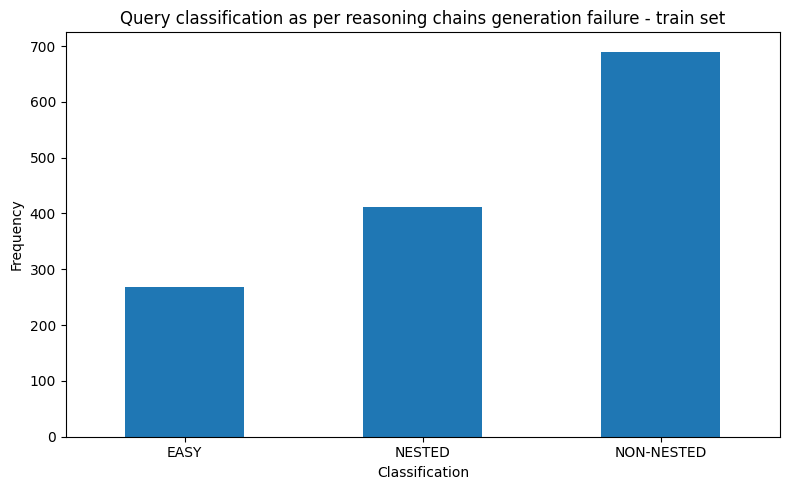

In [290]:
filtered_grouped = full_df[full_df["score"] == 0].groupby("classification")
classification_counts = filtered_grouped.size()
classification_counts
print(classification_counts)

# Plotting the classification counts
plt.figure(figsize=(8, 5))
classification_counts.plot(kind='bar')
plt.title("Query classification as per reasoning chains generation failure - train set")
plt.xlabel("Classification")
plt.ylabel("Frequency")
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


In [291]:
filtered_grouped = full_df[full_df["pred_error"] != ""].groupby("classification")
classification_counts = filtered_grouped.size()
classification_counts

classification
EASY          2610
NESTED         903
NON-NESTED    2194
dtype: int64

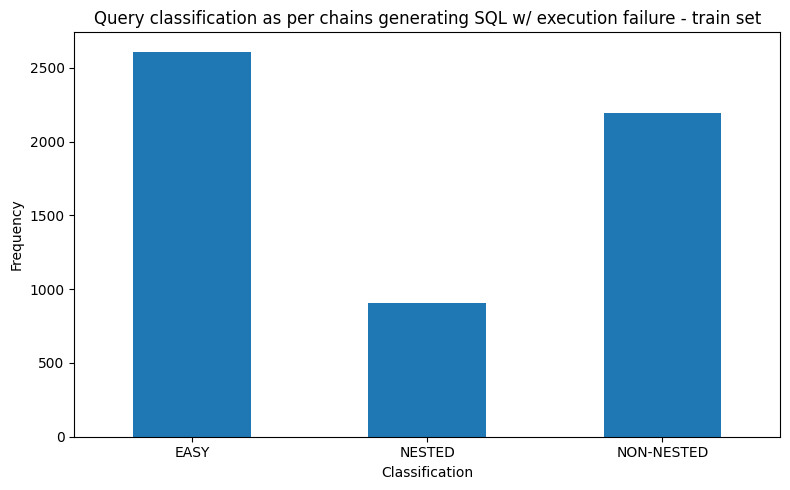

In [279]:
filtered_grouped = full_df[full_df["pred_error"] != ""].groupby("classification")
classification_counts = filtered_grouped.size()
classification_counts

# Plotting the classification counts
plt.figure(figsize=(8, 5))
classification_counts.plot(kind='bar')
plt.title("Query classification as per chains generating SQL w/ execution failure - train set")
plt.xlabel("Classification")
plt.ylabel("Frequency")
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


In [275]:
def get_error_percentages(df):
    full_df = df.copy()
    denom = 0
    schema_link_error_count = 0
    syntax_error_count = 0
    super_dim = 0
    no_exec_match = 0
    for idx, row in full_df.iterrows():
        # no error in gold truth execution and no execution match
        if not row['score'] and len(row['gold_results']) != 0:
            # print(idx, row['exec_match_error'])
            # if there is an error in predicted sql execution
            super_dim += 1
            if len(str(row["pred_error"])) > 0: 
                denom += 1
                # looking for wrong column selection basically fixing schema linking
                if "no such" in row['pred_error']:
                    used_schema = row['pred_error'].split(":")[-1].strip()
                    print(used_schema)
                    print(f"{'='*20}")
                    if used_schema in row['schema_links']:
                        schema_link_error_count += 1
                        full_df.at[idx, "pred_error_type"] = "incorrect schema classification error"
                        # print(f"schema links: {row['schema_links']}\nused schema: {used_schema}")
                        # print(f"{{'=='}*20}")
                    else:
                        schema_link_error_count += 1
                        full_df.at[idx, "pred_error_type"] = "hallucination given correct schema"
                elif "syntax error" in row["pred_error"]:
                    syntax_error_count += 1
                    full_df.at[idx, "pred_error_type"] = "syntax error"
            else:
                no_exec_match += 1
                    # print(row["pred_error"])


    # print(f"schema link error: {(schema_link_error_count / denom) * 100}")
    # print(f"syntax error: {(syntax_error_count/denom)*100}")

    schema_link_error_percentage = ((schema_link_error_count / denom) * 100) / (((schema_link_error_count / denom) * 100) + (syntax_error_count/denom)*100)
    syntax_error_percentage = 1 - schema_link_error_percentage
    execution_error_percentage = denom / super_dim
    no_execution_match = 1 - execution_error_percentage

    print(f"execution error %: {execution_error_percentage}")
    print(f"no execution match%: {no_execution_match}")
    print(f"schema link error %: {schema_link_error_percentage}")
    print(f"syntax error %: {syntax_error_percentage}")

    return full_df

### After running din sql we get below class of prediction errors

In [276]:
full_df = get_error_percentages(full_df)

playlists.playlist_id
playlists.playlist_id
station.zip_code
tracks.track_id
playlists.title
trust.score
name
Customers.Customer_Name
player.Position
Claim_Headers.Amount_Paid
country.Country
Campuses.Name
Campuses.Name
dept_locations.Dname
PROFESSOR.PROF_OFFICE
furniture.Market_Share
customer.no_of_customers
list.StudentID
park.name
list.StudentID
song.duration
song.duration
Document_Locations.Date_in_Location_To
song.duration
song.duration
list.StudentID
list.StudentID
song.title
home_game.g
song.duration
song.duration
song.duration
home_game.ghome
song.duration
product.max_page_size
Tryout.pTime
Department_Stores.department_name
Course.Room
Tryout.HS
Course.Room
Ref_Service_Types.Description
Bookings.Actual_Delivery_Date
Products.Category
Products.Category
Dorm.dorm_type
city
Manufacturers.City
airports.name
city.City_Name
appellations.Country
specific_value
appellations.Country
schema link error %: 0.6842105263157895
syntax error %: 0.3157894736842105


In [296]:
def get_error_plot(df_plot):

    df = df_plot.copy()
    
    error_counts = (
        df[(df['pred_error_type'].notna()) & (df['score'] == 0)]  # Filter rows with non-null pred_error_type
        .groupby(['classification', 'pred_error_type'])
        .size()
        .unstack(fill_value=0)  # Create a table where columns are error types
    )

    # Plotting the bar graph with customized colors
    colors = ['#1f77b4', '#ff7f0e', '#ff9999']  # Syntax error bar set to light red
    unique_error_types = error_counts.columns

    # Assign distinct colors dynamically based on error type count
    if len(unique_error_types) > len(colors):
        from matplotlib import cm
        import numpy as np
        cmap = cm.get_cmap('tab20', len(unique_error_types))
        colors = [cmap(i) for i in range(len(unique_error_types))]
        colors[unique_error_types.get_loc('syntax error')] = '#ff9999'  # Ensure syntax error remains light red

    error_counts.plot(
        kind='bar',
        figsize=(10, 6),
        color=[colors[unique_error_types.get_loc(err)] for err in unique_error_types]  # Match error type to color
    )
    
    plt.title('Schema Errors and Syntax Errors (by our model) by Query Class Type')
    plt.xlabel('Query Class Type')
    plt.ylabel('Error Count')
    plt.xticks(rotation=0)
    plt.legend(title='Error Type')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()


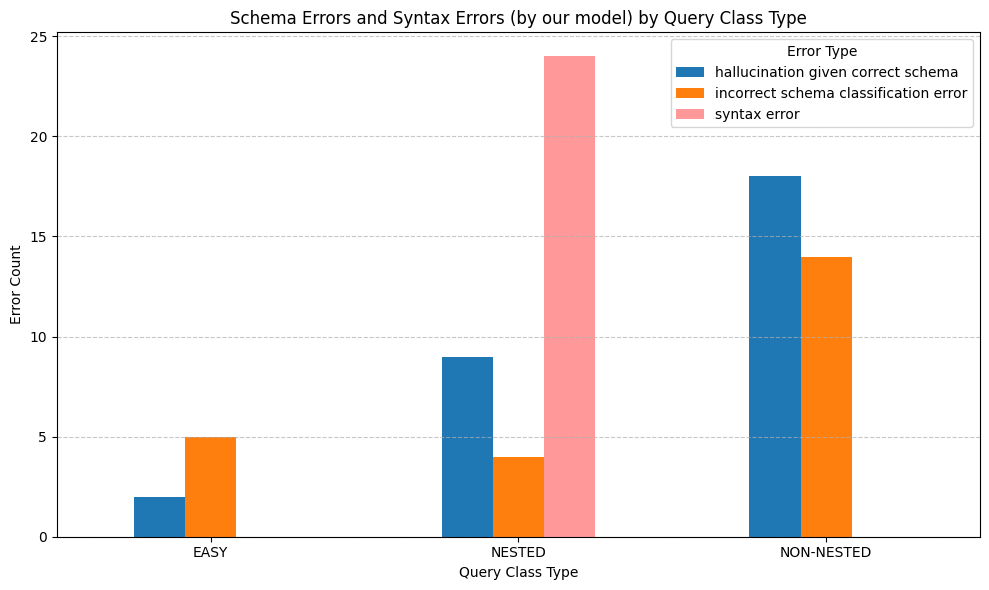

In [297]:
get_error_plot(full_df)

In [239]:
item = get_executions_tolerant(full_df)

[(63000.0, 168000.0, 91526.88888888889)]
[('Shannon', 'Senger'), ('Virginie', 'Hartmann'), ('Dariana', 'Bednar'), ('Verna', 'Grant'), ('Hoyt', 'Wintheiser'), ('Mayra', 'Hartmann'), ('Lizeth', 'Bartoletti'), ('Nova', 'Feest')]
[('Aliens',), ('MTV Cube',), ("Valentine's Day",), ('MTV Asia Aid',), ('Codehunters',), ('Carnival M is back!',)]
[('Town',), ('Village',)]
[('Wicked',), ('Rent',), ('Chicago',)]
[(3,)]
[(50, 2), (100, 1), (520, 6), (540, 2), (550, 5), (600, 18)]
[('Kamila Porczyk',), ('Anna Powierza',), ('Piotr Pręgowski',), ('Grażyna Wolszczak',), ('Maria Góralczyk',)]
[(10,)]
[('Boston',)]
[(232566.4274322169,)]
[('Władysław Grzywna',), ('Mariusz Zalejski',)]
[('+1 (403) 262-3443',)]
[('Angela Martinez',), ('Barbara Wilson',), ('Chad Stewart',), ('David Anderson',), ('Donald King',), ('Dorthy Lewis',), ('Elizabeth Taylor',), ('Eric Cooper',), ('Haywood Kelly',), ('Jennifer Thomas',), ('Joseph Thompson',), ('Karen Scott',), ('Lawrence Sperry',), ('Linda Davis',), ('Michael Mille

In [240]:
len(item[item.score ==1]) / len(item)

0.8598571428571429

In [ ]:
full_df.to_csv(f"din_sql_no_fields_stage_1_")

In [91]:
full_df

,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error
0,"Return the minimum, maximum, and average seati...",[track.Seating],"Table race, columns = [*,Race_ID,Name,Class,Da...",Foreign_keys = [race.Track_ID = track.Track_ID]\n,EASY,"SELECT MIN(track.Seating) AS min_seating, MAX(...","SELECT min(seating) , max(seating) , avg(sea...",race_track,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,NaN,NaN,NaN
1,what are the first name and last name of all c...,"[People.first_name, People.last_name, Candidat...","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Students.student_id = People.p...,NON-NESTED,"SELECT People.first_name, People.last_name FRO...","SELECT T2.first_name , T2.last_name FROM cand...",student_assessment,1. Sequential Structure: Start with the SELECT...,1.0,NaN,NaN,NaN,NaN
2,What are the themes of farm competitions sorte...,"[farm_competition.Theme, farm_competition.Year]","Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT farm_competition.Theme, farm_competitio...",SELECT Theme FROM farm_competition ORDER BY YE...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[('Aliens', 2002), ('MTV Cube', 2003), (""Valen...","[('Aliens',), ('MTV Cube',), (""Valentine's Day...",
3,"Return the different statuses of cities, ascen...",[city.Status],"Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT city.Status, COUNT(*) AS frequency FROM...",SELECT Status FROM city GROUP BY Status ORDER ...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[('Town', 1), ('Village', 4)]","[('Town',), ('Village',)]",
4,What are the names of musicals who have no act...,"[musical.Name, actor.Musical_ID = musical.Musi...","Table actor, columns = [*,Actor_ID,Name,Musica...",Foreign_keys = [actor.Musical_ID = actor.Actor...,NESTED,SELECT musical.Name FROM musical WHERE musical...,SELECT Name FROM musical WHERE Musical_ID NOT ...,musical,1. Sequential Structure: Start with the SELECT...,1.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6995,What is the nickname of the employee named Jan...,"[Staff.nickname, Staff.first_name, Staff.last_...","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Staff.staff_address_id = Addre...,EASY,SELECT Staff.nickname FROM Staff WHERE Staff.f...,SELECT nickname FROM Staff WHERE first_name = ...,driving_school,1. Sequential Structure: Start with the SELECT...,1.0,NaN,NaN,NaN,NaN
6996,Show the type of school and the number of buse...,"[school.Type, school_bus.School_ID = school.Sc...","Table driver, columns = [*,Driver_ID,Name,Part...",Foreign_keys = [school_bus.Driver_ID = driver....,NON-NESTED,"SELECT school.Type, COUNT(school_bus.School_ID...","SELECT T2.type , count(*) FROM school_bus AS ...",school_bus,1. Sequential Structure: Start with the SELECT...,1.0,NaN,NaN,NaN,NaN
6997,List the names of all scientists sorted in alp...,[Scientists.Name],"Table AssignedTo, columns = [*,Scientist,Proje...",Foreign_keys = [AssignedTo.Project = Projects....,EASY,SELECT Scientists.Name FROM Scientists ORDER B...,SELECT name FROM scientists ORDER BY name,scientist_1,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,NaN,NaN,NaN
6998,How long is the total lesson time taught by st...,"[Staff.first_name, Staff.last_name, Lessons.le...","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Staff.staff_address_id = Addre...,NON-NESTED,SELECT SUM(Lessons.lesson_time) FROM Lessons J...,SELECT sum(lesson_time) FROM Lessons AS T1 JOI...,driving_school,1. Sequential Structure: Start with the SELECT...,1.0,NaN,NaN,NaN,NaN


In [95]:
full_df["pred_error"].unique()

array([nan, '', 'no such column: playlists.playlist_id',
       'no such column: station.zip_code',
       'no such column: tracks.track_id',
       'no such column: playlists.title', 'near "SELECT": syntax error',
       'no such column: trust.score', 'no such column: name',
       'no such column: Customers.Customer_Name',
       'near "ALL": syntax error', 'no such column: player.Position',
       'no such column: Claim_Headers.Amount_Paid',
       'no such column: country.Country', 'no such column: Campuses.Name',
       'no such column: dept_locations.Dname',
       'no such column: PROFESSOR.PROF_OFFICE',
       'no such column: furniture.Market_Share',
       'no such column: customer.no_of_customers',
       'no such column: list.StudentID', 'no such column: park.name',
       'no such column: song.duration',
       'no such column: Document_Locations.Date_in_Location_To',
       'no such column: song.title', 'no such column: home_game.g',
       'no such column: home_game.ghom

In [105]:
def prompt_generator_for_pred_error(df):
    df_copy = df.copy()
    # rows where gold query exeuction did not fail
    for idx, row in df_copy[df_copy['exec_match_error'].isna()].iterrows():
        # no error in gold truth execution and no execution match
        if not row['score'] and len(row['gold_results']) != 0:
            # print(idx, row['exec_match_error'])
            # if there is an error in predicted sql execution
            if len(str(row["pred_error"])) > 0: 
                # looking for wrong column selection basically fixing schema linking
                if "no such column" in row['pred_error']:

                    system_prompt = f"""You are an expert in critiquing reasoning chains. Your task is to critque SQLite reasoning chains. These SQLite reasoning chains have been generated given user query, relevant schema links and foreign keys for a text-to-SQL task.
Your task is to critique the generated reasoning chains based on the execution error of generated SQLite query and ground truth SQLite query. The SQLite query generated based on the reasoning chains has an execution error because the SQLite query picked up schema that doesn't exist in the database. So look at the relevant schema links and the schema used in the ground truth SQLite query to correct

##
Instructions
Go step by step and critique the reasoning chains wherever necessary. 
In your critique, if you see wrong schema then always mention the correct schema by looking at the schema used in ground truth SQLite
The reasoning chains are in the form of the following subsections: Sequential Structure, Condition Structure, Join Structure, and Aggregation Structure. Your output should only contain these four subsections. 
Do not add an asterisk (**) in your output. 
Encapuslate critique of all the sections within a single <critique> and </critique> tag. 

##
The general structure of a reasoning chain:
1. Sequential Structure (Determine the order of SQL clauses: SELECT, FROM, JOIN, GROUP BY, ORDER BY, etc.)
2. Condition Structure (Apply filtering using WHERE or HAVING clauses to define specific conditions)
3. Join Structure (Use JOIN clauses to combine tables based on shared keys or relationships)
4. Aggregation Structure (Use aggregate functions like COUNT, SUM, AVG, etc., to summarize data)

##
Below is anexample for you to understand the task better:
### 
Example 1
#### 
User input
User question: Show the name and number of employees for the departments managed by heads whose temporary acting value is 'Yes'?

Generated Reasoning chains: 1. Sequential Structure: Start with the SELECT clause to retrieve the department name and number of employees. Use the FROM clause to specify the department table and JOIN it with the management and head tables to link departments with their heads. 2. Condition Structure: Use the WHERE clause to filter for heads whose temporary acting value is 'Yes'. 3. Join Structure: Use INNER JOINs between the department, management, and head tables based on their respective foreign keys to connect departments with their heads. 4. Aggregation Structure: Not needed, as we are retrieving specific records without any aggregation.

Generated incorrect SQLite query based on reasoning chains: SELECT department.Name, department.Num_Employees FROM department JOIN management ON department.Department_ID = management.department_ID JOIN head ON management.head_ID = head.head_ID WHERE head.temporary_acting = 'Yes';

Execution error of incorrect SQLite query: no such column: head.temporary_acting

Ground truth SQLite: SELECT T1.name ,  T1.num_employees FROM department AS T1 JOIN management AS T2 ON T1.department_id  =  T2.department_id WHERE T2.temporary_acting  =  'Yes'

#### 
Example 1 output
<critique>
Sequential Structure:
The reasoning chain begins correctly by identifying the SELECT clause and the need to retrieve fields from the department table (department name and number of employees). It also correctly recognizes the need to specify the department table in the FROM clause and to join with management and head tables. However, there is no explicit mention of aliasing the tables, which would be useful in ensuring clarity and avoiding potential conflicts in the query, as seen in the execution error.

Condition Structure:
The reasoning chain specifies that the WHERE clause should filter heads based on the temporary acting value being 'Yes'. This is conceptually correct, but it does not address the critical detail that `temporary_acting` is actually a column in the management table, not the head table. This misidentification directly leads to the execution error, as the generated SQL query attempts to access `head.temporary_acting` rather than the correct `management.temporary_acting`.

Join Structure:
The chain appropriately identifies the need to use INNER JOINs to link the department, management, and head tables based on the foreign keys. However, the reasoning chain does not clearly specify the use of aliases to avoid column ambiguity and improve readability. The absence of this detail in the reasoning chain contributes to the SQL execution error, as it results in an unclear reference to the `temporary_acting` column.

Aggregation Structure:
The reasoning chain correctly identifies that no aggregation is necessary because the query does not involve summary functions like COUNT or SUM. This part of the reasoning chain is valid and appropriately excludes aggregation in the final SQL statement.
</critique>
"""
                elif "syntax error" in row['pred_error']:
                    system_prompt = f"""You are an expert in critiquing SQLite based reasoning chains. These SQLite reasoning chains have been generated given user query, relevant schema links and foreign keys for a text-to-SQL task. The SQLite query generated based on the reasoning chains has syntax error.
Your task is to critique the generated reasoning chains based on the execution error of generated SQLite query and ground truth SQLite query. Make sure your critique points out the changes that must be made in the generated reasoning chains so that I can use your critique to later generate reasoning chains that'll lead to a correct SQLite query.

##
Instructions
Go step by step and critique the reasoning chains wherever necessary. 
The reasoning chains are in the form of the following subsections: Sequential Structure, Condition Structure, Join Structure, and Aggregation Structure. Your output should only contain these four subsections. 
Do not add an asterisk (**) in your output. 
Encapuslate critique of all the sections within a single <critique> and </critique> tag. 

##
The general structure of a reasoning chain:
1. Sequential Structure (Determine the order of SQL clauses: SELECT, FROM, JOIN, GROUP BY, ORDER BY, etc.)
2. Condition Structure (Apply filtering using WHERE or HAVING clauses to define specific conditions)
3. Join Structure (Use JOIN clauses to combine tables based on shared keys or relationships)
4. Aggregation Structure (Use aggregate functions like COUNT, SUM, AVG, etc., to summarize data)

##
Below is anexample for you to understand the task better:
### 
Example 1
#### 
User input
User question: What are the start station's name and id for the one that had the most start trips in August?

Generated reasoning chains: 1. Sequential Structure: Start with the SELECT clause to retrieve the start station's name and id. Use the FROM clause to specify the trip table, as we need to count the trips per start station. 2. Aggregation Structure: Use GROUP BY to group the results by start station id and name to count the number of trips for each station. 3. Condition Structure: Use a HAVING clause to filter for the month of August, ensuring we only consider trips that occurred in that month. 4. Order Structure: Use ORDER BY to sort the results by the count of trips in descending order, and limit the results to get the station with the most trips.

Generated incorrect SQLite query based on reasoning chains: SELECT station.name, station.id FROM trip JOIN station ON trip.start_station_id = station.id WHERE EXTRACT(MONTH FROM trip.start_date) = 8 GROUP BY station.id, station.name ORDER BY COUNT(trip.id) DESC LIMIT 1;

Execution error of incorrect SQLite query: near "FROM": syntax error

Ground truth SQLite: SELECT start_station_name ,  start_station_id FROM trip WHERE start_date LIKE "8/%" GROUP BY start_station_name ORDER BY COUNT(*) DESC LIMIT 1

#### Example 1 output
<critique>
Sequential Structure:  
The reasoning chain correctly identifies the need to use the SELECT clause to retrieve the start station's name and id and specifies the FROM clause to reference the trip table. However, it fails to correctly link the concept of extracting the month from the date with SQLite syntax. SQLite does not support the EXTRACT function, and the chain does not suggest an alternative, such as using a LIKE clause or string operations to filter for the month of August.

Condition Structure:  
The reasoning chain inaccurately specifies the use of the HAVING clause to filter trips for the month of August. The filtering condition is conceptually correct but misplaced since the appropriate filtering mechanism should occur in the WHERE clause for performance and syntax compatibility with SQLite. Additionally, the chain should have detailed that SQLite does not natively support EXTRACT, and a LIKE filter such as start_date LIKE "8/%" is needed.

Join Structure:  
The reasoning chain unnecessarily includes a join with the station table, which is not required for the task. The ground truth SQL demonstrates that all required fields (start station name and id) are already present in the trip table. This misstep introduces unnecessary complexity and potentially causes ambiguity in the query.

Aggregation Structure:  
The reasoning chain accurately identifies the need to use GROUP BY to group results by the start station name and id for counting trips. However, it overlooks simplifying the aggregation by focusing solely on the relevant fields present in the trip table and does not address the need to adjust aggregation for SQLite's syntax.

Order Structure:  
The reasoning chain correctly mentions sorting the results by the count of trips in descending order and limiting the output to a single record. This part of the chain aligns well with the query's intent, though the execution fails due to preceding errors in other sections.
</critique>
"""
                user_prompt = f"""User question: "{row['question']}"

Reasoning chains: {row['reasoning']}

Generated incorrect SQLite query based on reasoning chains: {row['predicted_sql']}

Execution error of incorrect SQL query: {row['pred_error']}

Ground truth SQL: {row['gold_sql']}"""

                df_copy.at[idx, 'system_prompt'] = system_prompt
                df_copy.at[idx, 'user_prompt'] = user_prompt
            
    return df_copy
  


In [99]:
def prompt_generator_for_syntax_error(df):
    df_copy = df.copy()
    # rows where gold query exeuction did not fail
    for idx, row in df_copy[df_copy['exec_match_error'].isna()].iterrows():
        # no error in gold truth execution and no execution match
        if not row['score'] and len(row['gold_results']) != 0:
            # print(idx, row['exec_match_error'])
            # if there is an error in predicted sql execution
            if len(str(row["pred_error"])) > 0: 
                # looking for wrong column selection basically fixing schema linking
                if "syntax error" in row['pred_error']:

                    system_prompt = f"""You are an expert in critiquing SQLite based reasoning chains. These SQLite reasoning chains have been generated given user query, relevant schema links and foreign keys for a text-to-SQL task. The SQLite query generated based on the reasoning chains has syntax error.
Your task is to critique the generated reasoning chains based on the execution error of generated SQLite query and ground truth SQLite query. 

##
Instructions
Go step by step and critique the reasoning chains wherever necessary. 
The reasoning chains are in the form of the following subsections: Sequential Structure, Condition Structure, Join Structure, and Aggregation Structure. Your output should only contain these four subsections. 
Do not add an asterisk (**) in your output. 
Encapuslate critique of all the sections within a single <critique> and </critique> tag. 

##
The general structure of a reasoning chain:
1. Sequential Structure (Determine the order of SQL clauses: SELECT, FROM, JOIN, GROUP BY, ORDER BY, etc.)
2. Condition Structure (Apply filtering using WHERE or HAVING clauses to define specific conditions)
3. Join Structure (Use JOIN clauses to combine tables based on shared keys or relationships)
4. Aggregation Structure (Use aggregate functions like COUNT, SUM, AVG, etc., to summarize data)

##
Below is anexample for you to understand the task better:
### 
Example 1
#### 
User input
User question: What are the start station's name and id for the one that had the most start trips in August?

Generated reasoning chains: 1. Sequential Structure: Start with the SELECT clause to retrieve the start station's name and id. Use the FROM clause to specify the trip table, as we need to count the trips per start station. 2. Aggregation Structure: Use GROUP BY to group the results by start station id and name to count the number of trips for each station. 3. Condition Structure: Use a HAVING clause to filter for the month of August, ensuring we only consider trips that occurred in that month. 4. Order Structure: Use ORDER BY to sort the results by the count of trips in descending order, and limit the results to get the station with the most trips.

Generated incorrect SQLite query based on reasoning chains: SELECT station.name, station.id FROM trip JOIN station ON trip.start_station_id = station.id WHERE EXTRACT(MONTH FROM trip.start_date) = 8 GROUP BY station.id, station.name ORDER BY COUNT(trip.id) DESC LIMIT 1;

Execution error of incorrect SQLite query: near "FROM": syntax error

Ground truth SQLite: SELECT start_station_name ,  start_station_id FROM trip WHERE start_date LIKE "8/%" GROUP BY start_station_name ORDER BY COUNT(*) DESC LIMIT 1

#### Example 1 output
<critique>
Sequential Structure:  
The reasoning chain correctly identifies the need to use the SELECT clause to retrieve the start station's name and id and specifies the FROM clause to reference the trip table. However, it fails to correctly link the concept of extracting the month from the date with SQLite syntax. SQLite does not support the EXTRACT function, and the chain does not suggest an alternative, such as using a LIKE clause or string operations to filter for the month of August.

Condition Structure:  
The reasoning chain inaccurately specifies the use of the HAVING clause to filter trips for the month of August. The filtering condition is conceptually correct but misplaced since the appropriate filtering mechanism should occur in the WHERE clause for performance and syntax compatibility with SQLite. Additionally, the chain should have detailed that SQLite does not natively support EXTRACT, and a LIKE filter such as start_date LIKE "8/%" is needed.

Join Structure:  
The reasoning chain unnecessarily includes a join with the station table, which is not required for the task. The ground truth SQL demonstrates that all required fields (start station name and id) are already present in the trip table. This misstep introduces unnecessary complexity and potentially causes ambiguity in the query.

Aggregation Structure:  
The reasoning chain accurately identifies the need to use GROUP BY to group results by the start station name and id for counting trips. However, it overlooks simplifying the aggregation by focusing solely on the relevant fields present in the trip table and does not address the need to adjust aggregation for SQLite's syntax.

Order Structure:  
The reasoning chain correctly mentions sorting the results by the count of trips in descending order and limiting the output to a single record. This part of the chain aligns well with the query's intent, though the execution fails due to preceding errors in other sections.
</critique>
"""
                user_prompt = f"""User question: "{row['question']}"

Reasoning chains: {row['reasoning']}

Generated incorrect SQLite query based on reasoning chains: {row['predicted_sql']}

Execution error of incorrect SQL query: {row['pred_error']}

Ground truth SQL: {row['gold_sql']}"""

                df_copy.at[idx, 'system_prompt'] = system_prompt
                df_copy.at[idx, 'user_prompt'] = user_prompt
            
    return df_copy
  


In [107]:
df_with_prompts_with_pred_error = prompt_generator_for_pred_error(full_df)
# df_with_prompts_with_pred_error[(df_with_prompts_with_pred_error.score==0) & (df_with_prompts_with_pred_error.pred_error.isna())]

In [36]:
df_with_prompts_with_pred_error = prompt_generator_for_pred_error(full_df)

row['score'] and len(row['gold_results']) != 0:

df_with_prompts_with_pred_error[(df_with_prompts_with_pred_error['score']!=1) & (df_with_prompts_with_pred_error.['gold_results'].not)]

,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error,system_prompt,user_prompt
0,"Return the minimum, maximum, and average seati...",[track.Seating],"Table race, columns = [*,Race_ID,Name,Class,Da...",Foreign_keys = [race.Track_ID = track.Track_ID]\n,EASY,"SELECT MIN(track.Seating) AS min_seating, MAX(...","SELECT min(seating) , max(seating) , avg(sea...",race_track,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,NaN,NaN,NaN,NaN,NaN
1,what are the first name and last name of all c...,"[People.first_name, People.last_name, Candidat...","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Students.student_id = People.p...,NON-NESTED,"SELECT People.first_name, People.last_name FRO...","SELECT T2.first_name , T2.last_name FROM cand...",student_assessment,1. Sequential Structure: Start with the SELECT...,1.0,NaN,NaN,NaN,NaN,NaN,NaN
2,What are the themes of farm competitions sorte...,"[farm_competition.Theme, farm_competition.Year]","Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT farm_competition.Theme, farm_competitio...",SELECT Theme FROM farm_competition ORDER BY YE...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[('Aliens', 2002), ('MTV Cube', 2003), (""Valen...","[('Aliens',), ('MTV Cube',), (""Valentine's Day...",,NaN,NaN
3,"Return the different statuses of cities, ascen...",[city.Status],"Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT city.Status, COUNT(*) AS frequency FROM...",SELECT Status FROM city GROUP BY Status ORDER ...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[('Town', 1), ('Village', 4)]","[('Town',), ('Village',)]",,NaN,NaN
4,What are the names of musicals who have no act...,"[musical.Name, actor.Musical_ID = musical.Musi...","Table actor, columns = [*,Actor_ID,Name,Musica...",Foreign_keys = [actor.Musical_ID = actor.Actor...,NESTED,SELECT musical.Name FROM musical WHERE musical...,SELECT Name FROM musical WHERE Musical_ID NOT ...,musical,1. Sequential Structure: Start with the SELECT...,1.0,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6995,What is the nickname of the employee named Jan...,"[Staff.nickname, Staff.first_name, Staff.last_...","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Staff.staff_address_id = Addre...,EASY,SELECT Staff.nickname FROM Staff WHERE Staff.f...,SELECT nickname FROM Staff WHERE first_name = ...,driving_school,1. Sequential Structure: Start with the SELECT...,1.0,NaN,NaN,NaN,NaN,NaN,NaN
6996,Show the type of school and the number of buse...,"[school.Type, school_bus.School_ID = school.Sc...","Table driver, columns = [*,Driver_ID,Name,Part...",Foreign_keys = [school_bus.Driver_ID = driver....,NON-NESTED,"SELECT school.Type, COUNT(school_bus.School_ID...","SELECT T2.type , count(*) FROM school_bus AS ...",school_bus,1. Sequential Structure: Start with the SELECT...,1.0,NaN,NaN,NaN,NaN,NaN,NaN
6997,List the names of all scientists sorted in alp...,[Scientists.Name],"Table AssignedTo, columns = [*,Scientist,Proje...",Foreign_keys = [AssignedTo.Project = Projects....,EASY,SELECT Scientists.Name FROM Scientists ORDER B...,SELECT name FROM scientists ORDER BY name,scientist_1,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,NaN,NaN,NaN,NaN,NaN
6998,How long is the total lesson time taught by st...,"[Staff.first_name, Staff.last_name, Lessons.le...","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Staff.staff_address_id = Addre...,NON-NESTED,SELECT SUM(Lessons.lesson_time) FROM Lessons J...,SELECT sum(lesson_time) FROM Lessons AS T1 JOI...,driving_school,1. Sequential Structure: Start with the SELECT...,1.0,NaN,NaN,NaN,NaN,NaN,NaN


In [148]:
df_with_prompts[df_with_prompts['exec_match_error'].notna()]

,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error,system_prompt,user_prompt
3285,What is the description of the type of the com...,"[ThirdPartyCompanies.companytype, MaintenanceC...","Table Asset_Parts, columns = [*,asset_id,part_...",Foreign_keys = [Maintenance_Contracts.maintena...,NESTED,SELECT Third_Party_Companies.company_type FROM...,SELECT T1.company_name FROM Third_Party_Compan...,assets_maintenance,1. Sequential Structure: Start with the SELECT...,0.0,gold query SELECT T1.company_name FROM Third_P...,"[('Maintenance Contractor',)]",[],,NaN,NaN
4007,What are the names of documents that have both...,"[Documents.documentname, Documents.documentstr...","Table Document_Functional_Areas, columns = [*,...",Foreign_keys = [Users.role_code = Roles.role_c...,NESTED,SELECT Documents.document_name FROM Documents ...,SELECT document_name FROM documents GROUP BY d...,document_management,1. Sequential Structure: Start with the SELECT...,0.0,gold query SELECT document_name FROM documents...,"[('Research about Art history',), ('Summer Sai...",[],,NaN,NaN
4513,Find the list of documents that are both in th...,"[Documents.documentcode, Documents.documenttyp...","Table Document_Functional_Areas, columns = [*,...",Foreign_keys = [Users.role_code = Roles.role_c...,NESTED,SELECT Documents.* FROM Documents JOIN Documen...,SELECT document_name FROM documents GROUP BY d...,document_management,1. Sequential Structure: Start with the SELECT...,0.0,gold query SELECT document_name FROM documents...,"[('621', '1', 'Paper', 8208, 'Research about A...",[],,NaN,NaN


In [112]:
def query_critique_for_syntax_error(df):
    df_copy = df.copy()
    # rows where gold query exeuction did not fail
    for idx, row in df_copy[df_copy['exec_match_error'].isna()].iterrows():
        # no error in gold truth execution and no execution match
        if not row['score'] and len(row['gold_results']) != 0:
            # print(idx, row['exec_match_error'])
            # if there is an error in predicted sql execution
            if len(str(row["pred_error"])) > 0 and "syntax error" in row['pred_error']: 
                try:
                    critique = GPT4_generation(row['system_prompt'],
                                            row['user_prompt'])
                    df_copy.at[idx, 'critique'] = critique.replace("<critique>", "").replace("</critique>", "").strip()
                except Exception as e:
                    df_copy.at[idx, 'critique'] = ""
                    df_copy.at[idx, 'error'] = str(e)
                print(f"{'='*20} running query number: {idx} {'='*20}")
    
    return df_copy

In [113]:
df_with_pred_error_critique = query_critique_for_syntax_error(df_with_prompts_with_pred_error)

==================== running query number: 891 ====================
==================== running query number: 1192 ====================
==================== running query number: 1315 ====================
==================== running query number: 1456 ====================
==================== running query number: 2103 ====================
==================== running query number: 2401 ====================
==================== running query number: 2598 ====================
==================== running query number: 3705 ====================
==================== running query number: 3723 ====================
==================== running query number: 3782 ====================
==================== running query number: 3877 ====================
==================== running query number: 4041 ====================
==================== running query number: 4272 ====================
==================== running query number: 4438 ====================
==================== running query 

In [67]:
df_with_pred_error_critique[(df_with_pred_error_critique.score==0) & (df_with_pred_error_critique.exec_match_error.isna() & (len(df_with_pred_error_critique.pred_results)>0))]

,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error,system_prompt,user_prompt,critique
2,What are the themes of farm competitions sorte...,"[farm_competition.Theme, farm_competition.Year]","Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT farm_competition.Theme, farm_competitio...",SELECT Theme FROM farm_competition ORDER BY YE...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[('Aliens', 2002), ('MTV Cube', 2003), (""Valen...","[('Aliens',), ('MTV Cube',), (""Valentine's Day...",,NaN,NaN,NaN
3,"Return the different statuses of cities, ascen...",[city.Status],"Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT city.Status, COUNT(*) AS frequency FROM...",SELECT Status FROM city GROUP BY Status ORDER ...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[('Town', 1), ('Village', 4)]","[('Town',), ('Village',)]",,NaN,NaN,NaN
8,How many male students (sex is 'M') are allerg...,"[Student.Sex, Student.StuID, Has_Allergy.StuID...","Table Allergy_Type, columns = [*,Allergy,Aller...",Foreign_keys = [Has_Allergy.Allergy = Allergy_...,NON-NESTED,SELECT COUNT(DISTINCT Student.StuID) FROM Stud...,"SELECT count(*) FROM Student WHERE sex = ""M""...",allergy_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[(21,)]","[(10,)]",,NaN,NaN,NaN
10,Find the average millisecond length of Latin a...,"[Track.Milliseconds, Track.GenreId, Genre.Name...","Table Album, columns = [*,AlbumId,Title,Artist...",Foreign_keys = [Album.ArtistId = Artist.Artist...,NON-NESTED,"SELECT Genre.Name, AVG(Track.Milliseconds) AS ...",SELECT AVG(Milliseconds) FROM GENRE AS T1 JOIN...,chinook_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Latin', 232859.26252158894), ('Pop', 229034...","[(232566.4274322169,)]",,NaN,NaN,NaN
13,What are the names of all employees who are no...,"[employee.name,certificate.eid,certificate.aid...","Table aircraft, columns = [*,aid,name,distance...","Foreign_keys = [flight.aid = aircraft.aid,cert...",NESTED,SELECT employee.name FROM employee WHERE emplo...,SELECT name FROM Employee EXCEPT SELECT T1.nam...,flight_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Karen Scott',), ('Lawrence Sperry',), ('Mic...","[('Angela Martinez',), ('Barbara Wilson',), ('...",,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6966,What are the appelations for wines produced af...,"[wine.Appelation, wine.Year, wine.Appelation =...","Table appellations, columns = [*,No,Appelation...",Foreign_keys = [wine.Appelation = appellations...,NESTED,SELECT wine.Appelation FROM wine JOIN appellat...,SELECT Appelation FROM WINE WHERE YEAR > 200...,wine_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Sonoma County',), ('California',), ('Carner...","[('Bennett Valley',), ('California',), ('Carne...",,NaN,NaN,NaN
6970,What are the names of ships that are commanded...,"[Ship.Name, captain.Rank, captain.Ship_ID = Sh...","Table Ship, columns = [*,Ship_ID,Name,Type,Bui...",Foreign_keys = [captain.Ship_ID = Ship.Ship_ID]\n,NESTED,SELECT Ship.Name FROM Ship JOIN captain ON cap...,SELECT t1.name FROM ship AS t1 JOIN captain AS...,ship_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('HMS Gorgon',), ('HMS Gorgon',)]","[('HMS Gorgon',)]",,NaN,NaN,NaN
6973,What are the last names that are used by custo...,"[Customers.last_name, Staff.last_name]","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Staff.staff_address_id = Addre...,NESTED,SELECT last_name FROM Customers UNION SELECT l...,SELECT last_name FROM Customers INTERSECT SELE...,driving_school,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Bernhard',), ('Bruen',), ('Carroll',), ('Do...","[('Mertz',)]",,NaN,NaN,NaN
6986,What is the first and 

In [114]:
def user_prompt_generation(row):
    user_prompt = f"""
User question: {row['question']}

Reasoning chains; {row['reasoning']}

Critique:{row['critique']}
Let's think step by step
"""

    return user_prompt


def query_correction_on_pred_error(df):
    system_prompt = f"""You are an expert in correcting reasoning chains and then generating corresponding SQLite query. For this task, you will get incorrect reasoning chains and the critique. You will use the critique and then correct the reasoning chains. After generating the corrected reasoning chains, you will generate SQLite query using the same thought process that you used to generate the corrected reasoning chains. Reasoning chains must be encapsulated in <chains> and </chains>. SQLite query must be encapsulated in <SQL> and </SQL>. See the example output given below.

# 
Example output
Let's think step by step
<chains>
1. Sequential Structure: Begin with SELECT clause to retrieve specific columns, followed by the FROM clause to specify the table source, and then use ORDER BY to sort by budget in descending order.
2. Condition Structure: No specific condition (WHERE clause) is needed as we are interested in the department with the highest budget.
3. Join Structure: Not required, as we only need data from the department table.
4. Aggregation Structure: Although no aggregate function is directly used, sorting by budget and limiting to the top result effectively gives us the department with the highest budget.
</chains>
<SQL>
SELECT dept_name, building
FROM department
ORDER BY budget DESC
LIMIT 1;
</SQL>

#
The general structure of a reasoning chain:
1. Sequential Structure (Determine the order of SQL clauses: SELECT, FROM, JOIN, GROUP BY, ORDER BY, etc.)
2. Condition Structure (Apply filtering using WHERE or HAVING clauses to define specific conditions)
3. Join Structure (Use JOIN clauses to combine tables based on shared keys or relationships)
4. Aggregation Structure (Use aggregate functions like COUNT, SUM, AVG, etc., to summarize data)

# 
Instructions
The SQL environment does not support placing parentheses around the individual SELECT statements in a UNION query"""
    df_copy = df.copy()
    # rows where gold query exeuction did not fail
    for idx, row in df_copy[df_copy['exec_match_error'].isna()].iterrows():
        # no error in gold truth execution and no execution match
        if not row['score'] and len(row['gold_results']) != 0:
            # print(idx, row['exec_match_error'])
            # if there is an error in predicted sql execution
            if len(str(row["pred_error"])) > 0 and "syntax error" in row['pred_error']: 
                print(f"{'='*20} running query number: {idx} {'='*20}")
                user_prompt = user_prompt_generation(row)
                output = GPT4_generation(system_prompt, user_prompt)
                reasoning_chains = re.search(r"<chains>(.*?)</chains>", output, re.DOTALL).group(1).strip()
                sql_query = re.search(r"<SQL>(.*?)</SQL>", output, re.DOTALL).group(1).strip()
                df_copy.at[idx, 'reasoning'] = reasoning_chains
                df_copy.at[idx, 'predicted_sql'] = sql_query

    return df_copy

In [115]:
df_with_critique_syntax_error = df_with_pred_error_critique.copy()
df_syntax_error_corrected  = query_correction_on_pred_error(df_with_critique_syntax_error)

==================== running query number: 891 ====================
==================== running query number: 1192 ====================
==================== running query number: 1315 ====================
==================== running query number: 1456 ====================
==================== running query number: 2103 ====================
==================== running query number: 2401 ====================
==================== running query number: 2598 ====================
==================== running query number: 3705 ====================
==================== running query number: 3723 ====================
==================== running query number: 3782 ====================
==================== running query number: 3877 ====================
==================== running query number: 4041 ====================
==================== running query number: 4272 ====================
==================== running query number: 4438 ====================
==================== running query 

In [207]:
syntax_error_corrected_tolerant_eval = get_executions_tolerant(df_syntax_error_corrected)

[(63000.0, 168000.0, 91526.88888888889)]
[('Shannon', 'Senger'), ('Virginie', 'Hartmann'), ('Dariana', 'Bednar'), ('Verna', 'Grant'), ('Hoyt', 'Wintheiser'), ('Mayra', 'Hartmann'), ('Lizeth', 'Bartoletti'), ('Nova', 'Feest')]
[('Aliens',), ('MTV Cube',), ("Valentine's Day",), ('MTV Asia Aid',), ('Codehunters',), ('Carnival M is back!',)]
[('Town',), ('Village',)]
[('Wicked',), ('Rent',), ('Chicago',)]
[(3,)]
[(50, 2), (100, 1), (520, 6), (540, 2), (550, 5), (600, 18)]
[('Kamila Porczyk',), ('Anna Powierza',), ('Piotr Pręgowski',), ('Grażyna Wolszczak',), ('Maria Góralczyk',)]
[(10,)]
[('Boston',)]
[(232566.4274322169,)]
[('Władysław Grzywna',), ('Mariusz Zalejski',)]
[('+1 (403) 262-3443',)]
[('Angela Martinez',), ('Barbara Wilson',), ('Chad Stewart',), ('David Anderson',), ('Donald King',), ('Dorthy Lewis',), ('Elizabeth Taylor',), ('Eric Cooper',), ('Haywood Kelly',), ('Jennifer Thomas',), ('Joseph Thompson',), ('Karen Scott',), ('Lawrence Sperry',), ('Linda Davis',), ('Michael Mille

In [280]:
filtered_grouped = syntax_error_corrected_tolerant_eval[syntax_error_corrected_tolerant_eval["pred_error"] != ""].groupby("classification")
classification_counts = filtered_grouped.size()
classification_counts



classification
EASY           7
NESTED        28
NON-NESTED    32
dtype: int64

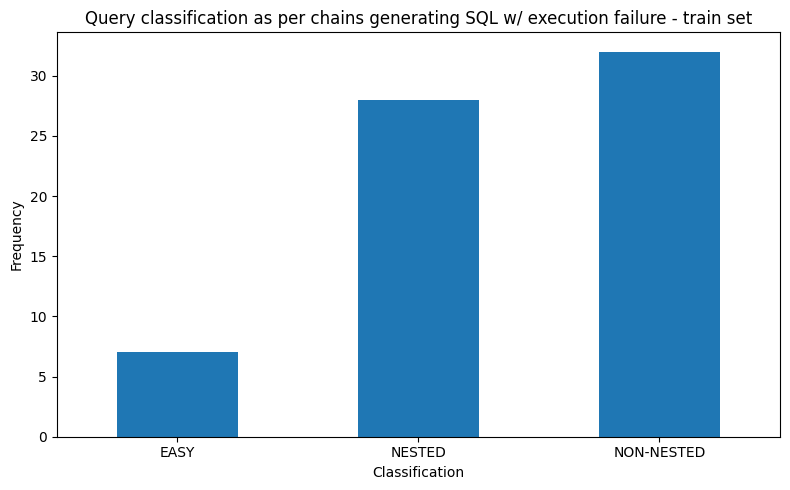

In [281]:
filtered_grouped = syntax_error_corrected_tolerant_eval[syntax_error_corrected_tolerant_eval["pred_error"] != ""].groupby("classification")
classification_counts = filtered_grouped.size()
classification_counts

# Plotting the classification counts
plt.figure(figsize=(8, 5))
classification_counts.plot(kind='bar')
plt.title("Query classification as per chains generating SQL w/ execution failure - train set")
plt.xlabel("Classification")
plt.ylabel("Frequency")
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


### After correcting syntax error below are different types of prediction errors

In [264]:
syntax_error_corrected_tolerant_eval = get_error_percentages(syntax_error_corrected_tolerant_eval)

schema link error %: 1.0
syntax error %: 0.0


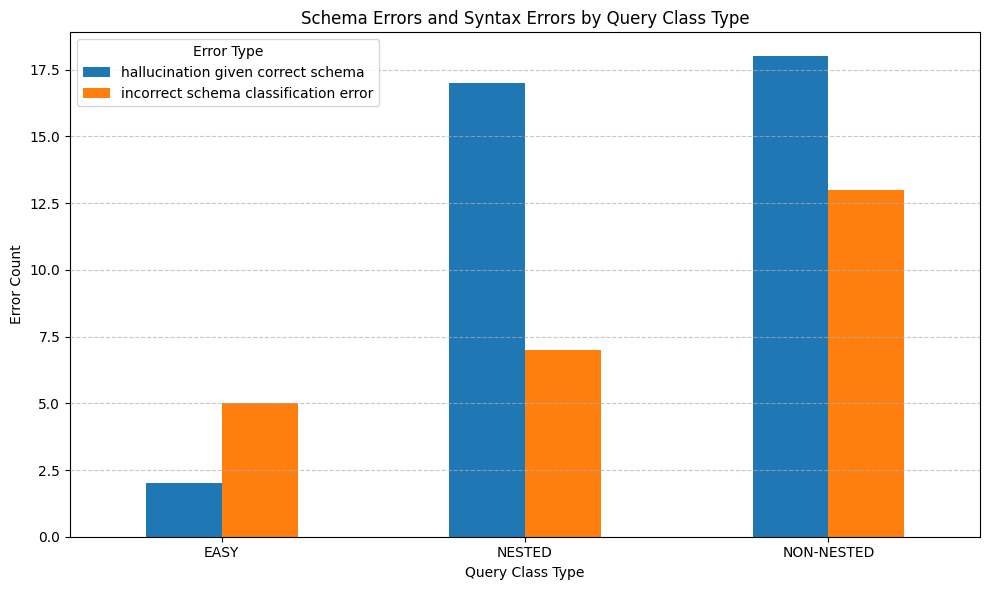

In [265]:
get_error_plot(syntax_error_corrected_tolerant_eval)

In [118]:
df_syntax_error_corrected_exec_match = get_executions(df_syntax_error_corrected)

In [210]:
len(syntax_error_corrected_tolerant_eval[syntax_error_corrected_tolerant_eval.score==1]) / len(syntax_error_corrected_tolerant_eval)

0.861

In [122]:
df_syntax_error_corrected_exec_match["pred_error"].unique()

array([nan, '', 'no such column: playlists.playlist_id',
       'no such column: station.zip_code',
       'no such column: tracks.track_id',
       'no such column: playlists.title', 'no such column: trust.score',
       'no such column: name', 'no such column: Customers.Customer_Name',
       'no such column: player.Position',
       'no such column: Claim_Headers.Amount_Paid',
       'no such column: country.Country', 'no such column: Campuses.Name',
       'no such column: dept_locations.Dname',
       'no such column: driver_id',
       'no such column: PROFESSOR.PROF_OFFICE',
       'no such column: furniture.Market_Share',
       'no such column: customer.no_of_customers',
       'no such column: list.StudentID', 'no such column: park.name',
       'no such column: song.duration', 'no such column: JOB_TITLE',
       'no such column: Document_Locations.Date_in_Location_To',
       'no such column: id', 'no such column: song.title',
       'no such column: home_game.g', 'no such c

In [124]:
df_syntax_error_corrected_exec_match[df_syntax_error_corrected_exec_match.score==0]

,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error,system_prompt,user_prompt,critique
2,What are the themes of farm competitions sorte...,"[farm_competition.Theme, farm_competition.Year]","Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT farm_competition.Theme, farm_competitio...",SELECT Theme FROM farm_competition ORDER BY YE...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[('Aliens', 2002), ('MTV Cube', 2003), (""Valen...","[('Aliens',), ('MTV Cube',), (""Valentine's Day...",,NaN,NaN,NaN
3,"Return the different statuses of cities, ascen...",[city.Status],"Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT city.Status, COUNT(*) AS frequency FROM...",SELECT Status FROM city GROUP BY Status ORDER ...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[('Town', 1), ('Village', 4)]","[('Town',), ('Village',)]",,NaN,NaN,NaN
8,How many male students (sex is 'M') are allerg...,"[Student.Sex, Student.StuID, Has_Allergy.StuID...","Table Allergy_Type, columns = [*,Allergy,Aller...",Foreign_keys = [Has_Allergy.Allergy = Allergy_...,NON-NESTED,SELECT COUNT(DISTINCT Student.StuID) FROM Stud...,"SELECT count(*) FROM Student WHERE sex = ""M""...",allergy_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[(21,)]","[(10,)]",,NaN,NaN,NaN
10,Find the average millisecond length of Latin a...,"[Track.Milliseconds, Track.GenreId, Genre.Name...","Table Album, columns = [*,AlbumId,Title,Artist...",Foreign_keys = [Album.ArtistId = Artist.Artist...,NON-NESTED,"SELECT Genre.Name, AVG(Track.Milliseconds) AS ...",SELECT AVG(Milliseconds) FROM GENRE AS T1 JOIN...,chinook_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Latin', 232859.26252158894), ('Pop', 229034...","[(232566.4274322169,)]",,NaN,NaN,NaN
13,What are the names of all employees who are no...,"[employee.name,certificate.eid,certificate.aid...","Table aircraft, columns = [*,aid,name,distance...","Foreign_keys = [flight.aid = aircraft.aid,cert...",NESTED,SELECT employee.name FROM employee WHERE emplo...,SELECT name FROM Employee EXCEPT SELECT T1.nam...,flight_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Karen Scott',), ('Lawrence Sperry',), ('Mic...","[('Angela Martinez',), ('Barbara Wilson',), ('...",,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6966,What are the appelations for wines produced af...,"[wine.Appelation, wine.Year, wine.Appelation =...","Table appellations, columns = [*,No,Appelation...",Foreign_keys = [wine.Appelation = appellations...,NESTED,SELECT wine.Appelation FROM wine JOIN appellat...,SELECT Appelation FROM WINE WHERE YEAR > 200...,wine_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Sonoma County',), ('California',), ('Carner...","[('Bennett Valley',), ('California',), ('Carne...",,NaN,NaN,NaN
6970,What are the names of ships that are commanded...,"[Ship.Name, captain.Rank, captain.Ship_ID = Sh...","Table Ship, columns = [*,Ship_ID,Name,Type,Bui...",Foreign_keys = [captain.Ship_ID = Ship.Ship_ID]\n,NESTED,SELECT Ship.Name FROM Ship JOIN captain ON cap...,SELECT t1.name FROM ship AS t1 JOIN captain AS...,ship_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('HMS Gorgon',), ('HMS Gorgon',)]","[('HMS Gorgon',)]",,NaN,NaN,NaN
6973,What are the last names that are used by custo...,"[Customers.last_name, Staff.last_name]","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Staff.staff_address_id = Addre...,NESTED,SELECT last_name FROM Customers UNION SELECT l...,SELECT last_name FROM Customers INTERSECT SELE...,driving_school,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[('Bernhard',), ('Bruen',), ('Carroll',), ('Do...","[('Mertz',)]",,NaN,NaN,NaN
6986,What is the first and 

In [147]:
df_syntax_error_corrected_exec_match.to_csv(f"train_syntax_correxted.csv")

In [125]:
df_column_critique_prompt = prompt_generator_for_pred_error(df_syntax_error_corrected_exec_match)

In [133]:
def query_critique_for_col_error(df):
    df_copy = df.copy()
    # rows where gold query exeuction did not fail
    for idx, row in df_copy[df_copy['exec_match_error'].isna()].iterrows():
        # no error in gold truth execution and no execution match
        if not row['score'] and len(row['gold_results']) != 0:
            # print(idx, row['exec_match_error'])
            # if there is an error in predicted sql execution
            if len(str(row["pred_error"])) > 0 and "no such column" in row['pred_error']: 
                print(row["pred_error"])
                try:
                    critique = GPT4_generation(row['system_prompt'],
                                            row['user_prompt'])
                    df_copy.at[idx, 'critique'] = critique.replace("<critique>", "").replace("</critique>", "").strip()
                except Exception as e:
                    df_copy.at[idx, 'critique'] = ""
                    df_copy.at[idx, 'error'] = str(e)
                print(f"{'='*20} running query number: {idx} {'='*20}")
    
    return df_copy

In [134]:
df_column_critique = query_critique_for_col_error(df_column_critique_prompt)

no such column: playlists.playlist_id
==================== running query number: 276 ====================
no such column: playlists.playlist_id
==================== running query number: 345 ====================
no such column: station.zip_code
==================== running query number: 402 ====================
no such column: tracks.track_id
==================== running query number: 555 ====================
no such column: playlists.title
==================== running query number: 706 ====================
no such column: trust.score
==================== running query number: 901 ====================
no such column: name
==================== running query number: 976 ====================
no such column: Customers.Customer_Name
==================== running query number: 1111 ====================
no such column: player.Position
==================== running query number: 1494 ====================
no such column: Claim_Headers.Amount_Paid
==================== running query number: 1525 ==

In [140]:
def user_prompt_generation(row):
    user_prompt = f"""
User question: {row['question']}

Reasoning chains; {row['reasoning']}

Critique:{row['critique']}
Let's think step by step
"""

    return user_prompt


def query_correction_on_col_error(df):
    system_prompt = f"""You are an expert in correcting reasoning chains and then generating corresponding SQLite query. For this task, you will get incorrect reasoning chains and the critique. You will use the critique and then correct the reasoning chains. After generating the corrected reasoning chains, you will generate SQLite query using the same thought process that you used to generate the corrected reasoning chains. Reasoning chains must be encapsulated in <chains> and </chains>. SQLite query must be encapsulated in <SQL> and </SQL>. See the example output given below.

# 
Example output
Let's think step by step
<chains>
1. Sequential Structure: Begin with SELECT clause to retrieve specific columns, followed by the FROM clause to specify the table source, and then use ORDER BY to sort by budget in descending order.
2. Condition Structure: No specific condition (WHERE clause) is needed as we are interested in the department with the highest budget.
3. Join Structure: Not required, as we only need data from the department table.
4. Aggregation Structure: Although no aggregate function is directly used, sorting by budget and limiting to the top result effectively gives us the department with the highest budget.
</chains>
<SQL>
SELECT dept_name, building
FROM department
ORDER BY budget DESC
LIMIT 1;
</SQL>

#
The general structure of a reasoning chain:
1. Sequential Structure (Determine the order of SQL clauses: SELECT, FROM, JOIN, GROUP BY, ORDER BY, etc.)
2. Condition Structure (Apply filtering using WHERE or HAVING clauses to define specific conditions)
3. Join Structure (Use JOIN clauses to combine tables based on shared keys or relationships)
4. Aggregation Structure (Use aggregate functions like COUNT, SUM, AVG, etc., to summarize data)

# 
Instructions
The SQL environment does not support placing parentheses around the individual SELECT statements in a UNION query"""
    df_copy = df.copy()
    # rows where gold query exeuction did not fail
    for idx, row in df_copy[df_copy['exec_match_error'].isna()].iterrows():
        # no error in gold truth execution and no execution match
        if not row['score'] and len(row['gold_results']) != 0:
            # print(idx, row['exec_match_error'])
            # if there is an error in predicted sql execution
            if len(str(row["pred_error"])) > 0 and "no such column" in row['pred_error']: 
                print(row['pred_error'])
                print(f"{'='*20} running query number: {idx} {'='*20}")
                user_prompt = user_prompt_generation(row)
                output = GPT4_generation(system_prompt, user_prompt)
                reasoning_chains = re.search(r"<chains>(.*?)</chains>", output, re.DOTALL).group(1).strip()
                sql_query = re.search(r"<SQL>(.*?)</SQL>", output, re.DOTALL).group(1).strip()
                df_copy.at[idx, 'reasoning'] = reasoning_chains
                df_copy.at[idx, 'predicted_sql'] = sql_query

    return df_copy

In [141]:
df_column_error_corrected = query_correction_on_col_error(df_column_critique)

no such column: playlists.playlist_id
==================== running query number: 276 ====================
no such column: playlists.playlist_id
==================== running query number: 345 ====================
no such column: station.zip_code
==================== running query number: 402 ====================
no such column: tracks.track_id
==================== running query number: 555 ====================
no such column: playlists.title
==================== running query number: 706 ====================
no such column: trust.score
==================== running query number: 901 ====================
no such column: name
==================== running query number: 976 ====================
no such column: Customers.Customer_Name
==================== running query number: 1111 ====================
no such column: player.Position
==================== running query number: 1494 ====================
no such column: Claim_Headers.Amount_Paid
==================== running query number: 1525 ==

In [155]:
df_column_error_corrected_exec_match = get_executions(df_column_error_corrected)
len(df_column_error_corrected_exec_match[df_column_error_corrected_exec_match.score==1]) / len(df_column_error_corrected_exec_match)

0.8042857142857143

In [282]:
col_error_corrected_tolerant_eval = get_executions_tolerant(df_column_error_corrected)
len(col_error_corrected_tolerant_eval[col_error_corrected_tolerant_eval.score==1]) / len(col_error_corrected_tolerant_eval)

[(63000.0, 168000.0, 91526.88888888889)]
[('Shannon', 'Senger'), ('Virginie', 'Hartmann'), ('Dariana', 'Bednar'), ('Verna', 'Grant'), ('Hoyt', 'Wintheiser'), ('Mayra', 'Hartmann'), ('Lizeth', 'Bartoletti'), ('Nova', 'Feest')]
[('Aliens',), ('MTV Cube',), ("Valentine's Day",), ('MTV Asia Aid',), ('Codehunters',), ('Carnival M is back!',)]
[('Town',), ('Village',)]
[('Wicked',), ('Rent',), ('Chicago',)]
[(3,)]
[(50, 2), (100, 1), (520, 6), (540, 2), (550, 5), (600, 18)]
[('Kamila Porczyk',), ('Anna Powierza',), ('Piotr Pręgowski',), ('Grażyna Wolszczak',), ('Maria Góralczyk',)]
[(10,)]
[('Boston',)]
[(232566.4274322169,)]
[('Władysław Grzywna',), ('Mariusz Zalejski',)]
[('+1 (403) 262-3443',)]
[('Angela Martinez',), ('Barbara Wilson',), ('Chad Stewart',), ('David Anderson',), ('Donald King',), ('Dorthy Lewis',), ('Elizabeth Taylor',), ('Eric Cooper',), ('Haywood Kelly',), ('Jennifer Thomas',), ('Joseph Thompson',), ('Karen Scott',), ('Lawrence Sperry',), ('Linda Davis',), ('Michael Mille

0.8658571428571429

In [283]:
filtered_grouped = col_error_corrected_tolerant_eval[col_error_corrected_tolerant_eval["pred_error"] != ""].groupby("classification")
classification_counts = filtered_grouped.size()
classification_counts

classification
EASY           3
NESTED        18
NON-NESTED     5
dtype: int64

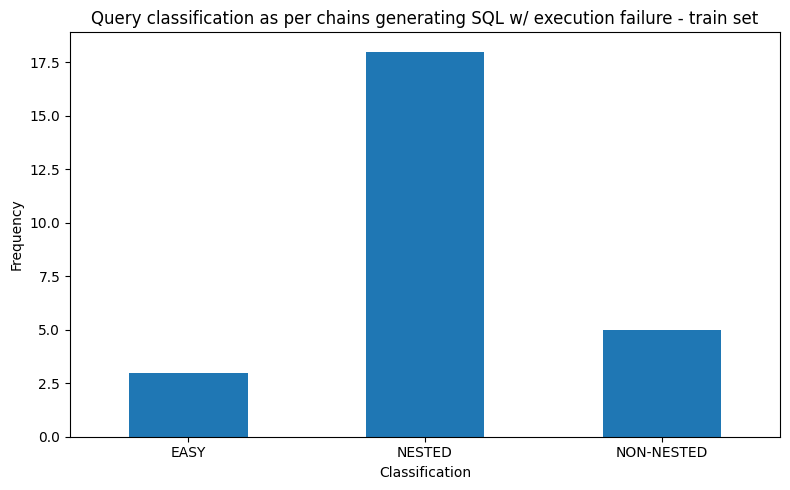

In [284]:

# Plotting the classification counts
plt.figure(figsize=(8, 5))
classification_counts.plot(kind='bar')
plt.title("Query classification as per chains generating SQL w/ execution failure - train set")
plt.xlabel("Classification")
plt.ylabel("Frequency")
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


In [285]:
col_error_corrected_tolerant_eval = get_error_percentages(col_error_corrected_tolerant_eval)

t1.customer_name
t.first_name
teachers.first_name
song.language
g.genre_name
team.team_name
T2.team_name
song.song_id
ds.store_id
S.Product
category
company
C2.country_name
schema link error %: 0.5652173913043478
syntax error %: 0.4347826086956522


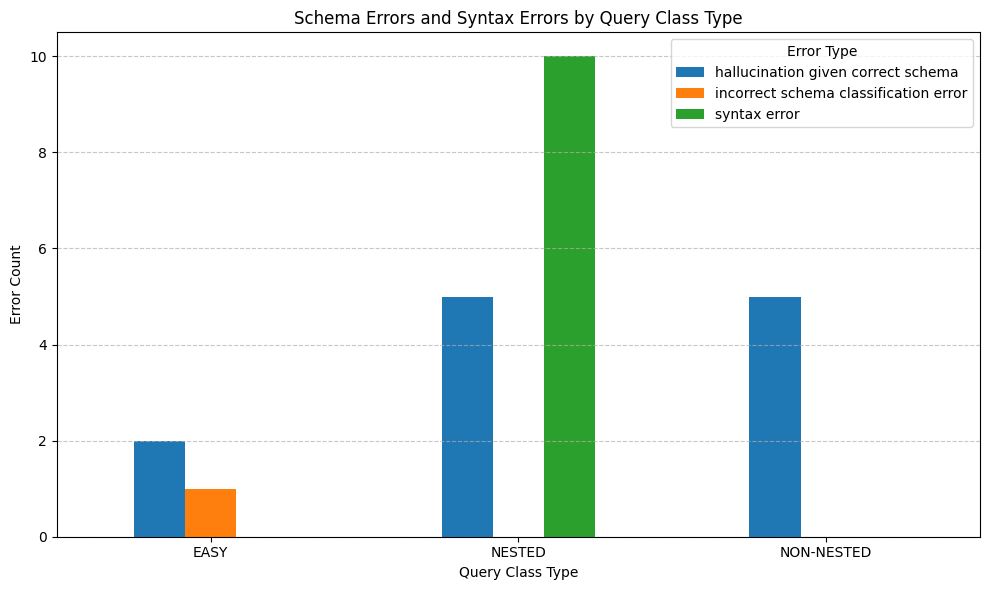

In [286]:
get_error_plot(col_error_corrected_tolerant_eval)

In [288]:
filtered_grouped = col_error_corrected_tolerant_eval[col_error_corrected_tolerant_eval["score"] == 0].groupby("classification")
classification_counts = filtered_grouped.size()
classification_counts



classification
EASY          169
NESTED        227
NON-NESTED    543
dtype: int64

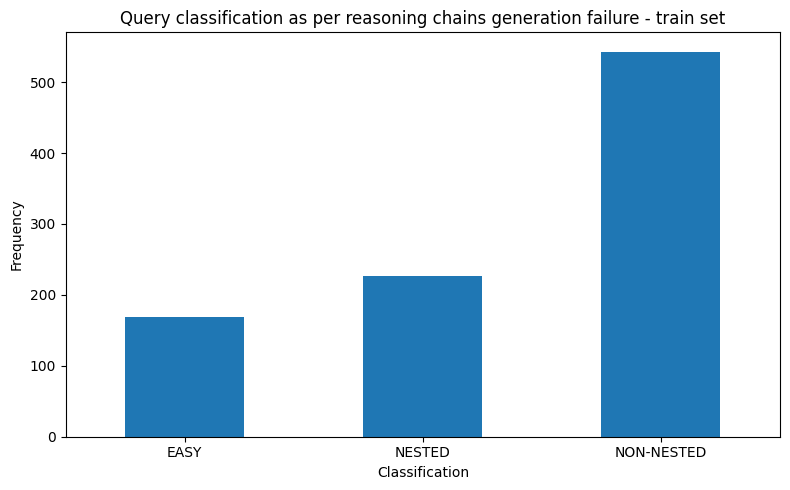

In [289]:
# Plotting the classification counts
plt.figure(figsize=(8, 5))
classification_counts.plot(kind='bar')
plt.title("Query classification as per reasoning chains generation failure - train set")
plt.xlabel("Classification")
plt.ylabel("Frequency")
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


In [162]:
def prompt_generator_wrong_execution_results(df):
    df_copy = df.copy()
    for idx, row in df_copy[df_copy['exec_match_error'].isna()].iterrows():
        if not row['score'] and len(row['gold_results']) != 0:
            print(idx, row['pred_error'])
            
            if len(str(row["pred_error"])) == 0: 
                system_prompt = f"""You are an expert in evaluating reasoning chains. Your task is to critique SQLite reasoning chains. These SQLite reasoning chains have been generated given user query, schema links, field values and foreign keys.
Your task is to critique the generated reasoning chains of the corresponding generated SQLite query based on execution of generated SQLite query, ground truth SQLite query, and execution of ground truth SQLite query. You also have access to SQLite query generated using the reasoning chains as given to you. The SQLite query generated based on the reasoning chains gives the wrong output. 

##
Instructions
Go step by step and critique the reasoning chains wherever necessary. 
The reasoning chains are in the form of the following subsections: Sequential Structure, Condition Structure, Join Structure, and Aggregation Structure. Your output should only contain the four subsections. 
Do not add an asterisk (**) in your output. 
Encapsulate critique of all the sections within a single <critique> and </critique> tag. 

##
The general structure of a reasoning chain:
1. Sequential Structure (Determine the order of SQL clauses: SELECT, FROM, JOIN, GROUP BY, ORDER BY, etc.)
2. Condition Structure (Apply filtering using WHERE or HAVING clauses to define specific conditions)
3. Join Structure (Use JOIN clauses to combine tables based on shared keys or relationships)
4. Aggregation Structure (Use aggregate functions like COUNT, SUM, AVG, etc., to summarize data)

##
Below are few examples for you to understand the task better:
### Example 1
#### User input
foreign keys: Foreign_keys = [management.head_ID = head.head_ID,management.department_ID = department.Department_ID]

User question:
How many departments are led by heads who are not mentioned?

Schema_links:
[management.department_ID, management.head_ID, head.head_ID]

Reasoning chains:
1. Sequential Structure: Start with the SELECT clause to retrieve the count of departments. Use the FROM clause to specify the management table, as it contains the relationship between departments and heads. 2. Condition Structure: Use a WHERE clause to filter for departments led by heads who are not mentioned. This can be done by checking for head IDs that do not exist in the head table. 3. Join Structure: Not required, as we can filter directly from the management table based on the absence of head IDs in the head table. 4. Aggregation Structure: Use COUNT to aggregate the number of departments that meet the specified condition.

Generated SQL query based on reasoning chains:
SELECT COUNT(*) FROM management WHERE head_ID NOT IN (SELECT head_ID FROM head);

Execution results of generated SQL query:
[(0,)]

Ground truth SQL:
SELECT count(*) FROM department WHERE department_id NOT IN (SELECT department_id FROM management);

Execution results of ground truth SQL:
[(11,)]

#### Example 1 output
<critique>
Sequential Structure:
The reasoning chain correctly starts with the intention to count departments. However, it incorrectly specifies using the `management` table as the primary table, which leads to a misunderstanding of the data relationship. The correct approach would involve the `department` table as the primary table, focusing on departments that lack a corresponding head entry in the `management` table. This incorrect choice of table is a significant issue that contributes to the incorrect SQL output.

Condition Structure:
The reasoning chain attempts to filter for "departments led by heads who are not mentioned," suggesting a WHERE clause to check for head IDs that do not exist in the `head` table. However, this interpretation is incorrect as it should focus on departments without any associated entry in the `management` table rather than on heads themselves. The correct condition should verify if `department_id` in the `department` table is absent in the `management` table, reflecting departments that are not managed by any head.

Join Structure:
The reasoning chain claims that a join is unnecessary, as filtering can be done directly on the `management` table. This is incorrect because the primary table of interest is `department`, and we are actually looking for departments with no association in `management`. This approach fails to account for the proper relationship needed to identify departments without a management entry, leading to a misinterpretation of the required SQL logic.

Aggregation Structure:
The reasoning chain correctly specifies using COUNT to get the number of departments meeting the condition, which aligns with the user’s request. However, due to the incorrect sequential and condition structures, the COUNT function is applied to an erroneous subset of data. The COUNT aggregation should apply to the filtered `department` records that do not appear in `management`, rather than a count based on the `management` table.
</critique>

### Example 2
#### User input
foreign keys: Foreign_keys = Foreign_keys = [farm_competition.Host_city_ID = city.City_ID,competition_record.Farm_ID = farm.Farm_ID,competition_record.Competition_ID = farm_competition.Competition_ID]

User question:
Show the status shared by cities with population bigger than 1500 and smaller than 500.

Schema_links:
[city.Status, city.Population, 1500, 500]

Reasoning chains:
1. Sequential Structure: Start with the SELECT clause to retrieve the "Status" field from the "city" table. Use the FROM clause to specify the "city" table as the source of data. 2. Condition Structure: Apply a WHERE clause to filter cities based on their population, specifically those with a population greater than 1500 and less than 500. However, since no city can have a population that is both greater than 1500 and less than 500 simultaneously, this condition will yield no results. 3. Join Structure: Not required, as we are only querying data from the city table. 4. Aggregation Structure: Not needed, as we are not performing any aggregation; we are simply retrieving the status of cities based on the specified conditions.

Generated SQL query based on reasoning chains:
SELECT Status FROM city WHERE Population > 1500 AND Population < 500;

Execution results of generated SQL query:
[]

Ground truth SQL:
SELECT Status FROM city WHERE Population  >  1500 INTERSECT SELECT Status FROM city WHERE Population  <  500

Execution results of ground truth SQL:
[('Village',)]

#### Example 2 output
<critique>
Sequential Structure:
The reasoning chain correctly identifies the need to select the "Status" field from the "city" table. However, it incorrectly combines the population conditions (`Population > 1500` and `Population < 500`) within a single WHERE clause, leading to an impossible condition that yields no results. The correct approach would involve using two separate queries for each population condition and combining them with an INTERSECT operation, which is missing from this reasoning chain.

Condition Structure:
The reasoning chain acknowledges that no city can meet both population conditions simultaneously but does not adjust the approach to handle this. Instead of combining the conditions in one WHERE clause, it should have recommended using separate WHERE clauses in two queries and then intersecting the results to find statuses common to both conditions. This misunderstanding of the condition structure is a critical error, as it prevents the query from returning any results.

Join Structure:
The reasoning chain correctly identifies that no join is necessary since all relevant data is contained within the "city" table. This part of the reasoning chain is appropriate given the structure of the query and database schema.

Aggregation Structure:
The reasoning chain appropriately notes that no aggregation is necessary, as the task is to retrieve non-aggregated "Status" values based on the population conditions. However, due to errors in the sequential and condition structures, the aggregation structure becomes irrelevant in the generated query. The reasoning chain should have mentioned the need for an INTERSECT operation, which serves to filter for common statuses across the two conditions rather than aggregate data.
</critique>
"""
                user_prompt = f"""foreign keys: {row['foriegn keys']}

User question: {row['question']}

Schema_links: {row['schema_links']}

Reasoning chains: {row['reasoning']}

Generated SQL query based on reasoning chains:{row['predicted_sql']}

Execution results of generated SQL query: {row['pred_results']}

Ground truth SQL: {row['gold_sql']}

Execution results of ground truth SQL: {row['gold_results']}"""

                df_copy.at[idx, 'system_prompt'] = system_prompt
                df_copy.at[idx, 'user_prompt'] = user_prompt
    
    return df_copy
  


In [163]:
df_wrong_executions_prompt = prompt_generator_wrong_execution_results(df_column_error_corrected_exec_match)

2 
3 
8 
10 
13 
15 
16 
21 
23 
26 
30 
34 
45 
54 
56 
61 
66 
69 
72 
75 
80 
93 
94 
95 
96 
101 
104 
106 
120 
122 
126 
129 
130 
136 
143 
144 
152 
160 
161 
170 
176 
179 
185 
190 
192 
204 
207 
208 
212 
215 
218 
219 
223 
241 
245 
247 
258 
259 
262 
265 
266 
269 
275 
276 
279 
286 
287 
289 
292 
294 
297 
299 
307 
312 
313 
328 
333 
336 
343 
345 
348 
349 
355 
356 
360 
363 
365 
382 
383 
384 
392 
394 
402 
403 
407 
408 
414 
415 
419 
425 
433 
434 
439 
441 
452 
458 
463 
464 
466 
469 
472 
478 
480 
486 
497 
500 
504 
508 
516 
519 
524 
532 
551 
555 
560 
563 
565 
566 
568 
579 
580 
583 
588 
596 
621 
622 
641 
644 
646 
676 
680 
681 
689 
690 
697 
698 
706 
717 
718 
720 
726 
727 
729 
730 
751 
759 
766 
770 
771 
772 
773 
774 
776 
779 
783 
784 
792 
795 
797 
799 
802 
804 
824 
827 
836 
840 
844 
847 
850 
851 
855 
856 
858 
864 
870 
872 
873 
875 
891 
894 
897 
900 
901 
908 
923 
929 
930 
955 
957 
968 
969 
973 
976 
990 
991 
994

In [164]:
def query_critique_wrong_executions(df):
    df_copy = df.copy()
    for idx, row in df_copy[df_copy['exec_match_error'].isna()].iterrows():
        if not row['score'] and len(row['gold_results']) != 0:
            if len(str(row["pred_error"])) == 0:
                try:
                    critique = GPT4_generation(row['system_prompt'],
                                            row['user_prompt'])
                    df_copy.at[idx, 'critique'] = critique.replace("<critique>", "").replace("</critique>", "").strip()
                    print(f"{'='*20} running query number: {idx} {'='*20}")
                except Exception as e:
                    df_copy.at[idx, 'critique'] = ""
                    df_copy.at[idx, 'error'] = str(e)
                
    
    return df_copy

In [166]:
df_wrong_executions_critique = query_critique_wrong_executions(df_wrong_executions_prompt)

==================== running query number: 2 ====================
==================== running query number: 3 ====================
==================== running query number: 8 ====================
==================== running query number: 10 ====================
==================== running query number: 13 ====================
==================== running query number: 15 ====================
==================== running query number: 16 ====================
==================== running query number: 21 ====================
==================== running query number: 23 ====================
==================== running query number: 26 ====================
==================== running query number: 30 ====================
==================== running query number: 34 ====================
==================== running query number: 45 ====================
==================== running query number: 54 ====================
==================== running query number: 56 ===================

In [170]:
def user_prompt_generation(row):
    user_prompt = f"""
User question: {row['question']}

Reasoning chains; {row['reasoning']}

Critique:{row['critique']}
Let's think step by step
"""

    return user_prompt


def query_correction_wrong_executions(df):
    system_prompt = f"""You are an expert in correcting reasoning chains and then generating corresponding SQLite query. For this task, you will get incorrect reasoning chains and the critique. You will use the critique and then correct the reasoning chains. After generating the corrected reasoning chains, you will generate SQLite query using the same thought process that you used to generate the corrected reasoning chains. Reasoning chains must be encapsulated in <chains> and </chains>. SQLite query must be encapsulated in <SQL> and </SQL>. See the example output given below.

# 
Instructions
The SQL environment does not support placing parentheses around the individual SELECT statements in a UNION query

#
The general structure of a reasoning chain:
1. Sequential Structure (Determine the order of SQL clauses: SELECT, FROM, JOIN, GROUP BY, ORDER BY, etc.)
2. Condition Structure (Apply filtering using WHERE or HAVING clauses to define specific conditions)
3. Join Structure (Use JOIN clauses to combine tables based on shared keys or relationships)
4. Aggregation Structure (Use aggregate functions like COUNT, SUM, AVG, etc., to summarize data)

# 
Example output
Let's think step by step
<chains>
1. Sequential Structure: Begin with SELECT clause to retrieve specific columns, followed by the FROM clause to specify the table source, and then use ORDER BY to sort by budget in descending order.
2. Condition Structure: No specific condition (WHERE clause) is needed as we are interested in the department with the highest budget.
3. Join Structure: Not required, as we only need data from the department table.
4. Aggregation Structure: Although no aggregate function is directly used, sorting by budget and limiting to the top result effectively gives us the department with the highest budget.
</chains>
<SQL>
SELECT dept_name, building
FROM department
ORDER BY budget DESC
LIMIT 1;
</SQL>"""
    df_copy = df.copy()
    # rows where gold query exeuction did not fail
    for idx, row in df_copy[df_copy['exec_match_error'].isna()].iterrows():
        # no error in gold truth execution and no execution match
        if not row['score'] and len(row['gold_results']) != 0:
            # print(idx, row['exec_match_error'])
            # if there is an error in predicted sql execution
            if len(str(row["pred_error"])) == 0: 
                print(row['pred_error'])
                print(f"{'='*20} running query number: {idx} {'='*20}")
                user_prompt = user_prompt_generation(row)
                try:
                    output = GPT4_generation(system_prompt, user_prompt)
                    reasoning_chains = re.search(r"<chains>(.*?)</chains>", output, re.DOTALL).group(1).strip()
                    sql_query = re.search(r"<SQL>(.*?)</SQL>", output, re.DOTALL).group(1).strip()
                    df_copy.at[idx, 'reasoning'] = reasoning_chains
                    df_copy.at[idx, 'predicted_sql'] = sql_query
                except Exception as e:
                    df_copy.at[idx, 'reasoning'] = ""
                    df_copy.at[idx, 'predicted_sql']  = ""
                    df_copy.at[idx, 'error'] = str(e)
                    print(f"{str(e)}")

    return df_copy

In [171]:
df_wrong_executions_corrected = query_correction_wrong_executions(df_wrong_executions_critique)


==================== running query number: 2 ====================

==================== running query number: 3 ====================

==================== running query number: 8 ====================

==================== running query number: 10 ====================

==================== running query number: 13 ====================

==================== running query number: 15 ====================

==================== running query number: 16 ====================

==================== running query number: 21 ====================

==================== running query number: 23 ====================

==================== running query number: 26 ====================

==================== running query number: 30 ====================

==================== running query number: 34 ====================

==================== running query number: 45 ====================

==================== running query number: 54 ====================

==================== running query number: 56 ====

In [175]:
df_wrong_executions_corrected_exec_match[df_wrong_executions_corrected_exec_match.score==0]

,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error,system_prompt,user_prompt,critique,error
2,What are the themes of farm competitions sorte...,"[farm_competition.Theme, farm_competition.Year]","Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,SELECT Theme \nFROM farm_competition \nORDER...,SELECT Theme FROM farm_competition ORDER BY YE...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[('Aliens',), ('MTV Cube',), (""Valentine's Day...","[('Aliens',), ('MTV Cube',), (""Valentine's Day...",,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [farm_competition...,Sequential Structure:\nThe reasoning chain cor...,NaN
3,"Return the different statuses of cities, ascen...",[city.Status],"Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,SELECT DISTINCT Status \nFROM city \nORDER B...,SELECT Status FROM city GROUP BY Status ORDER ...,farm,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[('Town',), ('Village',)]","[('Town',), ('Village',)]",,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [farm_competition...,Sequential Structure:\nThe reasoning chain cor...,NaN
8,How many male students (sex is 'M') are allerg...,"[Student.Sex, Student.StuID, Has_Allergy.StuID...","Table Allergy_Type, columns = [*,Allergy,Aller...",Foreign_keys = [Has_Allergy.Allergy = Allergy_...,NON-NESTED,SELECT COUNT(*)\nFROM Student\nJOIN Has_Allerg...,"SELECT count(*) FROM Student WHERE sex = ""M""...",allergy_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[(18,)]","[(10,)]",,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [Has_Allergy.Alle...,Sequential Structure:\nThe reasoning chain cor...,NaN
10,Find the average millisecond length of Latin a...,"[Track.Milliseconds, Track.GenreId, Genre.Name...","Table Album, columns = [*,AlbumId,Title,Artist...",Foreign_keys = [Album.ArtistId = Artist.Artist...,NON-NESTED,SELECT AVG(Track.Milliseconds) AS AverageMilli...,SELECT AVG(Milliseconds) FROM GENRE AS T1 JOIN...,chinook_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[(232566.4274322169,)]","[(232566.4274322169,)]",,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [Album.ArtistId =...,Sequential Structure:\nThe reasoning chain cor...,NaN
13,What are the names of all employees who are no...,"[employee.name,certificate.eid,certificate.aid...","Table aircraft, columns = [*,aid,name,distance...","Foreign_keys = [flight.aid = aircraft.aid,cert...",NESTED,SELECT name\nFROM employee\nEXCEPT\nSELECT e.n...,SELECT name FROM Employee EXCEPT SELECT T1.nam...,flight_1,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,[],"[('Angela Martinez',), ('Barbara Wilson',), ('...",no such column: e.ID,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [flight.aid = air...,Sequential Structure:\nThe reasoning chain cor...,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6966,What are the appelations for wines produced af...,"[wine.Appelation, wine.Year, wine.Appelation =...","Table appellations, columns = [*,No,Appelation...",Foreign_keys = [wine.Appelation = appellations...,NESTED,SELECT appellation\nFROM wine\nINNER JOIN appe...,SELECT Appelation FROM WINE WHERE YEAR > 200...,wine_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,[],"[('Bennett Valley',), ('California',), ('Carne...",no such column: appellation,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [wine.Appelation ...,Sequential Structure:\nThe reasoning chain cor...,NaN
6970,What are the names of ships that are commanded...,"[Ship.Name, captain.Rank, captain.Ship_ID = Sh...","Table Ship, columns = [*,Ship_ID,Name,Type,Bui...",Foreign

In [186]:
df_wrong_executions_corrected_exec_match_tolerant = get_executions_tolerant(df_wrong_executions_corrected_exec_match
)

[(63000.0, 168000.0, 91526.88888888889)]
[('Shannon', 'Senger'), ('Virginie', 'Hartmann'), ('Dariana', 'Bednar'), ('Verna', 'Grant'), ('Hoyt', 'Wintheiser'), ('Mayra', 'Hartmann'), ('Lizeth', 'Bartoletti'), ('Nova', 'Feest')]
[('Aliens',), ('MTV Cube',), ("Valentine's Day",), ('MTV Asia Aid',), ('Codehunters',), ('Carnival M is back!',)]
[('Town',), ('Village',)]
[('Wicked',), ('Rent',), ('Chicago',)]
[(3,)]
[(50, 2), (100, 1), (520, 6), (540, 2), (550, 5), (600, 18)]
[('Kamila Porczyk',), ('Anna Powierza',), ('Piotr Pręgowski',), ('Grażyna Wolszczak',), ('Maria Góralczyk',)]
[(10,)]
[('Boston',)]
[(232566.4274322169,)]
[('Władysław Grzywna',), ('Mariusz Zalejski',)]
[('+1 (403) 262-3443',)]
[('Angela Martinez',), ('Barbara Wilson',), ('Chad Stewart',), ('David Anderson',), ('Donald King',), ('Dorthy Lewis',), ('Elizabeth Taylor',), ('Eric Cooper',), ('Haywood Kelly',), ('Jennifer Thomas',), ('Joseph Thompson',), ('Karen Scott',), ('Lawrence Sperry',), ('Linda Davis',), ('Michael Mille

In [187]:
df_wrong_executions_corrected_exec_match_tolerant

,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error,system_prompt,user_prompt,critique,error
0,"Return the minimum, maximum, and average seati...",[track.Seating],"Table race, columns = [*,Race_ID,Name,Class,Da...",Foreign_keys = [race.Track_ID = track.Track_ID]\n,EASY,"SELECT MIN(track.Seating) AS min_seating, MAX(...","SELECT min(seating) , max(seating) , avg(sea...",race_track,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,"[(63000.0, 168000.0, 91526.88888888889)]","[(63000.0, 168000.0, 91526.88888888889)]",,NaN,NaN,NaN,NaN
1,what are the first name and last name of all c...,"[People.first_name, People.last_name, Candidat...","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Students.student_id = People.p...,NON-NESTED,"SELECT People.first_name, People.last_name FRO...","SELECT T2.first_name , T2.last_name FROM cand...",student_assessment,1. Sequential Structure: Start with the SELECT...,1.0,NaN,"[('Shannon', 'Senger'), ('Virginie', 'Hartmann...","[('Shannon', 'Senger'), ('Virginie', 'Hartmann...",,NaN,NaN,NaN,NaN
2,What are the themes of farm competitions sorte...,"[farm_competition.Theme, farm_competition.Year]","Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,SELECT Theme \nFROM farm_competition \nORDER...,SELECT Theme FROM farm_competition ORDER BY YE...,farm,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,"[('Aliens',), ('MTV Cube',), (""Valentine's Day...","[('Aliens',), ('MTV Cube',), (""Valentine's Day...",,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [farm_competition...,Sequential Structure:\nThe reasoning chain cor...,NaN
3,"Return the different statuses of cities, ascen...",[city.Status],"Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,SELECT DISTINCT Status \nFROM city \nORDER B...,SELECT Status FROM city GROUP BY Status ORDER ...,farm,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,"[('Town',), ('Village',)]","[('Town',), ('Village',)]",,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [farm_competition...,Sequential Structure:\nThe reasoning chain cor...,NaN
4,What are the names of musicals who have no act...,"[musical.Name, actor.Musical_ID = musical.Musi...","Table actor, columns = [*,Actor_ID,Name,Musica...",Foreign_keys = [actor.Musical_ID = actor.Actor...,NESTED,SELECT musical.Name FROM musical WHERE musical...,SELECT Name FROM musical WHERE Musical_ID NOT ...,musical,1. Sequential Structure: Start with the SELECT...,1.0,NaN,"[('Wicked',), ('Rent',), ('Chicago',)]","[('Wicked',), ('Rent',), ('Chicago',)]",,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6995,What is the nickname of the employee named Jan...,"[Staff.nickname, Staff.first_name, Staff.last_...","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Staff.staff_address_id = Addre...,EASY,SELECT Staff.nickname FROM Staff WHERE Staff.f...,SELECT nickname FROM Staff WHERE first_name = ...,driving_school,1. Sequential Structure: Start with the SELECT...,1.0,NaN,"[('thompson.constantin',)]","[('thompson.constantin',)]",,NaN,NaN,NaN,NaN
6996,Show the type of school and the number of buse...,"[school.Type, school_bus.School_ID = school.Sc...","Table driver, columns = [*,Driver_ID,Name,Part...",Foreign_keys = [school_bus.Driver_ID = driver....,NON-NESTED,"SELECT school.Type, COUNT(school_bus.School_ID...","SELECT T2.type , count(*) FROM school_bus AS ...",school_bus,1. Sequential Structure: Start with the SELECT...,1.0,NaN,"[('Private', 3), ('Public', 2)]","[('Private', 3), ('Public', 2)]",,NaN,NaN,NaN,NaN
6997,List the names of all scientists sorted in alp...,[Scientists.Name],"Table AssignedTo, columns = [*,Scientist,Proje...",Foreign_keys = [AssignedTo.Project = 

In [188]:
len(df_wrong_executions_corrected_exec_match_tolerant[df_wrong_executions_corrected_exec_match_tolerant.score==1]) / len(df_wrong_executions_corrected_exec_match_tolerant)

0.9027142857142857

In [ ]:
### 

### Best train set

In [242]:
df_wrong_executions_corrected_exec_match_tolerant

,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error,system_prompt,user_prompt,critique,error,pred_error_type
0,"Return the minimum, maximum, and average seati...",[track.Seating],"Table race, columns = [*,Race_ID,Name,Class,Da...",Foreign_keys = [race.Track_ID = track.Track_ID]\n,EASY,"SELECT MIN(track.Seating) AS min_seating, MAX(...","SELECT min(seating) , max(seating) , avg(sea...",race_track,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,"[(63000.0, 168000.0, 91526.88888888889)]","[(63000.0, 168000.0, 91526.88888888889)]",,NaN,NaN,NaN,NaN,NaN
1,what are the first name and last name of all c...,"[People.first_name, People.last_name, Candidat...","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Students.student_id = People.p...,NON-NESTED,"SELECT People.first_name, People.last_name FRO...","SELECT T2.first_name , T2.last_name FROM cand...",student_assessment,1. Sequential Structure: Start with the SELECT...,1.0,NaN,"[('Shannon', 'Senger'), ('Virginie', 'Hartmann...","[('Shannon', 'Senger'), ('Virginie', 'Hartmann...",,NaN,NaN,NaN,NaN,NaN
2,What are the themes of farm competitions sorte...,"[farm_competition.Theme, farm_competition.Year]","Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,SELECT Theme \nFROM farm_competition \nORDER...,SELECT Theme FROM farm_competition ORDER BY YE...,farm,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,"[('Aliens',), ('MTV Cube',), (""Valentine's Day...","[('Aliens',), ('MTV Cube',), (""Valentine's Day...",,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [farm_competition...,Sequential Structure:\nThe reasoning chain cor...,NaN,NaN
3,"Return the different statuses of cities, ascen...",[city.Status],"Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,SELECT DISTINCT Status \nFROM city \nORDER B...,SELECT Status FROM city GROUP BY Status ORDER ...,farm,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,"[('Town',), ('Village',)]","[('Town',), ('Village',)]",,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [farm_competition...,Sequential Structure:\nThe reasoning chain cor...,NaN,NaN
4,What are the names of musicals who have no act...,"[musical.Name, actor.Musical_ID = musical.Musi...","Table actor, columns = [*,Actor_ID,Name,Musica...",Foreign_keys = [actor.Musical_ID = actor.Actor...,NESTED,SELECT musical.Name FROM musical WHERE musical...,SELECT Name FROM musical WHERE Musical_ID NOT ...,musical,1. Sequential Structure: Start with the SELECT...,1.0,NaN,"[('Wicked',), ('Rent',), ('Chicago',)]","[('Wicked',), ('Rent',), ('Chicago',)]",,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6995,What is the nickname of the employee named Jan...,"[Staff.nickname, Staff.first_name, Staff.last_...","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Staff.staff_address_id = Addre...,EASY,SELECT Staff.nickname FROM Staff WHERE Staff.f...,SELECT nickname FROM Staff WHERE first_name = ...,driving_school,1. Sequential Structure: Start with the SELECT...,1.0,NaN,"[('thompson.constantin',)]","[('thompson.constantin',)]",,NaN,NaN,NaN,NaN,NaN
6996,Show the type of school and the number of buse...,"[school.Type, school_bus.School_ID = school.Sc...","Table driver, columns = [*,Driver_ID,Name,Part...",Foreign_keys = [school_bus.Driver_ID = driver....,NON-NESTED,"SELECT school.Type, COUNT(school_bus.School_ID...","SELECT T2.type , count(*) FROM school_bus AS ...",school_bus,1. Sequential Structure: Start with the SELECT...,1.0,NaN,"[('Private', 3), ('Public', 2)]","[('Private', 3), ('Public', 2)]",,NaN,NaN,NaN,NaN,NaN
6997,List the names of all scientists sorted in alp...,[Scientists.Name],"Table AssignedTo, columns = [*,Scientist

In [266]:
df_wrong_executions_corrected_exec_match_tolerant = get_error_percentages(df_wrong_executions_corrected_exec_match_tolerant)

schema link error %: 0.9391025641025641
syntax error %: 0.0608974358974359


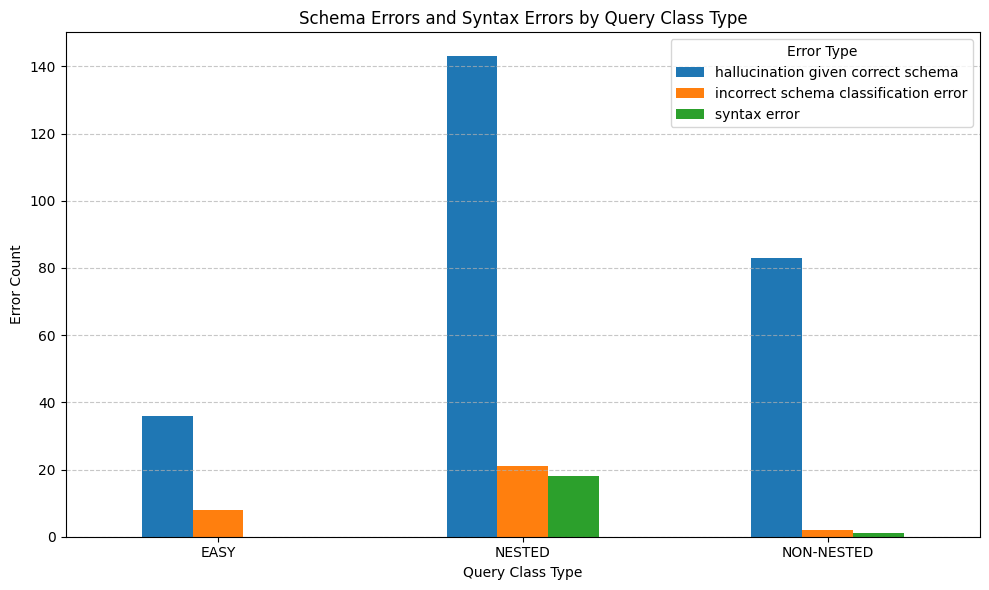

In [267]:
get_error_plot(df_wrong_executions_corrected_exec_match_tolerant)

In [268]:
len(df_pred_error_corrected_exec_match_tolerant[df_pred_error_corrected_exec_match_tolerant.score==1]) / len(df_pred_error_corrected_exec_match_tolerant)

0.8645714285714285

In [243]:
df_wrong_executions_corrected_exec_match_tolerant[["question", 
                        "classification",
                        "db_id", 
                        "schema_links", 
                        "fields", 
                        "foriegn keys", 
                        "predicted_sql", 
                        "gold_sql", 
                        "reasoning", 
                        "score"]].to_json(f"best_train.json")



#### % of incorrect chains generaiton

In [244]:
(len(df_wrong_executions_corrected_exec_match_tolerant[df_wrong_executions_corrected_exec_match_tolerant["score"] == 0]) / len(df_wrong_executions_corrected_exec_match_tolerant)) * 100

9.728571428571428

In [245]:
(len(df_wrong_executions_corrected_exec_match_tolerant[df_wrong_executions_corrected_exec_match_tolerant["pred_error"] != ""]) / len(df_wrong_executions_corrected_exec_match_tolerant)) * 100

4.671428571428572

In [246]:
filtered_grouped = df_wrong_executions_corrected_exec_match_tolerant[df_wrong_executions_corrected_exec_match_tolerant["pred_error"] != ""].groupby("classification")
classification_counts = filtered_grouped.size()
classification_counts

classification
EASY           44
NESTED        192
NON-NESTED     91
dtype: int64

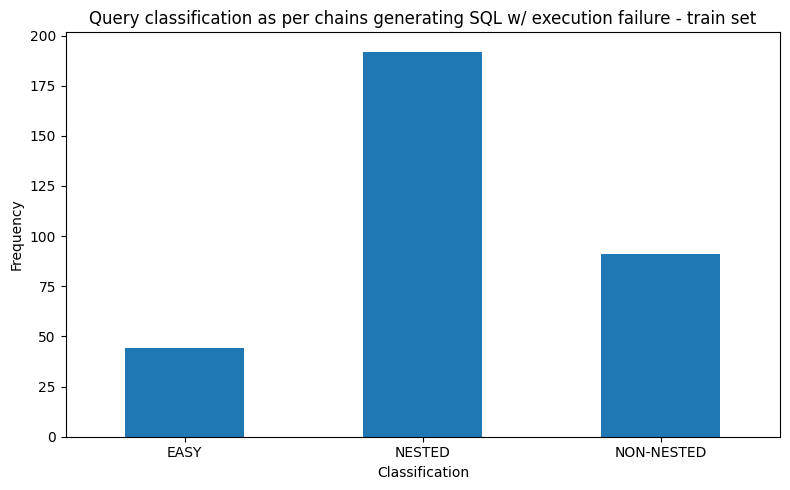

In [247]:
# Plotting the classification counts
plt.figure(figsize=(8, 5))
classification_counts.plot(kind='bar')
plt.title("Query classification as per chains generating SQL w/ execution failure - train set")
plt.xlabel("Classification")
plt.ylabel("Frequency")
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


In [277]:
filtered_grouped = df_wrong_executions_corrected_exec_match_tolerant[df_wrong_executions_corrected_exec_match_tolerant["score"] == 0].groupby("classification")
classification_counts = filtered_grouped.size()
classification_counts

classification
EASY          131
NESTED        254
NON-NESTED    296
dtype: int64

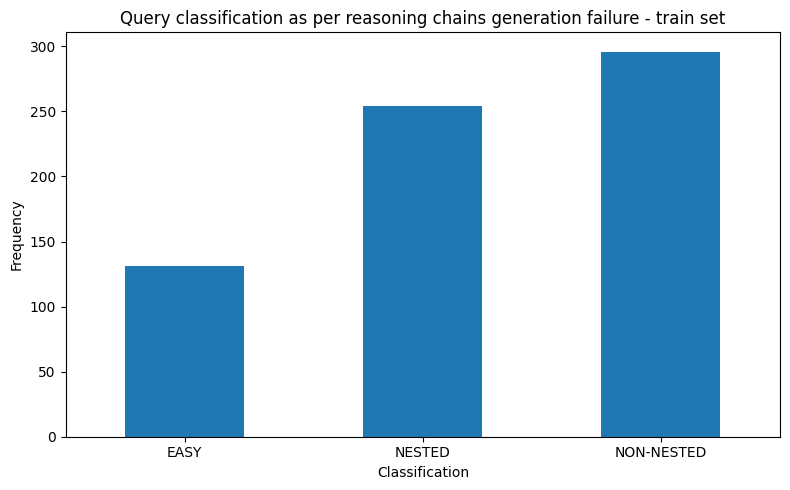

In [287]:
filtered_grouped = df_wrong_executions_corrected_exec_match_tolerant[df_wrong_executions_corrected_exec_match_tolerant["score"] == 0].groupby("classification")
classification_counts = filtered_grouped.size()
classification_counts

# Plotting the classification counts
plt.figure(figsize=(8, 5))
classification_counts.plot(kind='bar')
plt.title("Query classification as per reasoning chains generation failure - train set")
plt.xlabel("Classification")
plt.ylabel("Frequency")
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


In [191]:
df_pred_error_corrected_exec_match_tolerant.to_csv(f"final_train_set_new.csv")

In [189]:
df_wrong_executions_corrected_exec_match_tolerant[df_wrong_executions_corrected_exec_match_tolerant.system_prompt.notna()]

,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error,system_prompt,user_prompt,critique,error
2,What are the themes of farm competitions sorte...,"[farm_competition.Theme, farm_competition.Year]","Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,SELECT Theme \nFROM farm_competition \nORDER...,SELECT Theme FROM farm_competition ORDER BY YE...,farm,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,"[('Aliens',), ('MTV Cube',), (""Valentine's Day...","[('Aliens',), ('MTV Cube',), (""Valentine's Day...",,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [farm_competition...,Sequential Structure:\nThe reasoning chain cor...,NaN
3,"Return the different statuses of cities, ascen...",[city.Status],"Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,SELECT DISTINCT Status \nFROM city \nORDER B...,SELECT Status FROM city GROUP BY Status ORDER ...,farm,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,"[('Town',), ('Village',)]","[('Town',), ('Village',)]",,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [farm_competition...,Sequential Structure:\nThe reasoning chain cor...,NaN
8,How many male students (sex is 'M') are allerg...,"[Student.Sex, Student.StuID, Has_Allergy.StuID...","Table Allergy_Type, columns = [*,Allergy,Aller...",Foreign_keys = [Has_Allergy.Allergy = Allergy_...,NON-NESTED,SELECT COUNT(*)\nFROM Student\nJOIN Has_Allerg...,"SELECT count(*) FROM Student WHERE sex = ""M""...",allergy_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,"[(18,)]","[(10,)]",,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [Has_Allergy.Alle...,Sequential Structure:\nThe reasoning chain cor...,NaN
10,Find the average millisecond length of Latin a...,"[Track.Milliseconds, Track.GenreId, Genre.Name...","Table Album, columns = [*,AlbumId,Title,Artist...",Foreign_keys = [Album.ArtistId = Artist.Artist...,NON-NESTED,SELECT AVG(Track.Milliseconds) AS AverageMilli...,SELECT AVG(Milliseconds) FROM GENRE AS T1 JOIN...,chinook_1,1. Sequential Structure: Start with the SELECT...,1.0,NaN,"[(232566.4274322169,)]","[(232566.4274322169,)]",,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [Album.ArtistId =...,Sequential Structure:\nThe reasoning chain cor...,NaN
13,What are the names of all employees who are no...,"[employee.name,certificate.eid,certificate.aid...","Table aircraft, columns = [*,aid,name,distance...","Foreign_keys = [flight.aid = aircraft.aid,cert...",NESTED,SELECT name\nFROM employee\nEXCEPT\nSELECT e.n...,SELECT name FROM Employee EXCEPT SELECT T1.nam...,flight_1,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,[],"[('Angela Martinez',), ('Barbara Wilson',), ('...",no such column: e.ID,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [flight.aid = air...,Sequential Structure:\nThe reasoning chain cor...,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6966,What are the appelations for wines produced af...,"[wine.Appelation, wine.Year, wine.Appelation =...","Table appellations, columns = [*,No,Appelation...",Foreign_keys = [wine.Appelation = appellations...,NESTED,SELECT appellation\nFROM wine\nINNER JOIN appe...,SELECT Appelation FROM WINE WHERE YEAR > 200...,wine_1,1. Sequential Structure: Start with the SELECT...,0.0,NaN,[],"[('Bennett Valley',), ('California',), ('Carne...",no such column: appellation,You are an expert in evaluating reasoning chai...,foreign keys: Foreign_keys = [wine.Appelation ...,Sequential Structure:\nThe reasoning chain cor...,NaN
6970,What are the names of ships that are commanded...,"[Ship.Name, captain.Rank, captain.Ship_ID = Sh...","Table Ship, columns = [*,Ship_ID,Name,Type,Bui...",Foreign

In [173]:
df_wrong_executions_corrected_exec_match = get_executions(df_wrong_executions_corrected)

In [174]:
len(df_wrong_executions_corrected_exec_match[df_wrong_executions_corrected_exec_match.score==1]) / len(df_wrong_executions_corrected_exec_match)

0.8042857142857143

In [143]:
df_column_error_corrected_exec_match.to_csv(f"train_syntax_col_corrected.csv")

In [117]:
df_syntax_error_corrected_exec_match.to_csv(f"train_syntax_corrected.csv")

In [70]:
df_pred_error_corrected[(df_pred_error_corrected.system_prompt.notna())]

,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error,system_prompt,user_prompt,critique
276,What are the names of all playlists that have ...,"[playlists.name, playlist_tracks.playlist_id, ...","Table albums, columns = [*,id,title,artist_id]...","Foreign_keys = [albums.artist_id = artists.id,...",NON-NESTED,SELECT T2.name\nFROM playlist_tracks T1\nINNER...,SELECT T2.name FROM playlist_tracks AS T1 JOIN...,store_1,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,[],"[('Music',), ('TV Shows',), ('90’s Music',), (...",no such column: playlists.playlist_id,You are an expert in evaluating reasoning chai...,"User question: ""What are the names of all play...",Sequential Structure:\nThe reasoning chain cor...
345,List the name of playlist which has number of ...,"[playlists.name,playlist_tracks.playlist_id,pl...","Table albums, columns = [*,id,title,artist_id]...","Foreign_keys = [albums.artist_id = artists.id,...",NON-NESTED,SELECT T2.name\nFROM playlist_tracks T1\nINNER...,SELECT T2.name FROM playlist_tracks AS T1 JOIN...,store_1,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,[],"[('Music',), ('TV Shows',), ('90’s Music',), (...",no such column: playlists.playlist_id,You are an expert in evaluating reasoning chai...,"User question: ""List the name of playlist whic...",Sequential Structure:\nThe reasoning chain cor...
402,What zip codes have a station with a max tempe...,"[station.zip_code, weather.date, weather.max_t...","Table station, columns = [*,id,name,lat,long,d...",Foreign_keys = [status.station_id = station.id]\n,NON-NESTED,"SELECT zip_code, date\nFROM weather\nWHERE max...","SELECT date , zip_code FROM weather WHERE max...",bike_1,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,[],"[('9/6/2013', 94107), ('9/7/2013', 94107), ('9...",no such column: station.zip_code,You are an expert in evaluating reasoning chai...,"User question: ""What zip codes have a station ...",Sequential Structure:\nThe reasoning chain cor...
555,Find the name of tracks which are in both Movi...,"[tracks.name,playlist_tracks.track_id,playlist...","Table albums, columns = [*,id,title,artist_id]...","Foreign_keys = [albums.artist_id = artists.id,...",NESTED,SELECT tracks.name\nFROM tracks\nINNER JOIN pl...,SELECT T1.name FROM tracks AS T1 JOIN playlist...,store_1,1. Sequential Structure: Start with two SELECT...,0.0,NaN,[],[],no such column: tracks.track_id,You are an expert in evaluating reasoning chai...,"User question: ""Find the name of tracks which ...",Sequential Structure:\nThe reasoning chain cor...
706,What are the names of all tracks that are on p...,"[tracks.name, playlists.title, playlist_tracks...","Table albums, columns = [*,id,title,artist_id]...","Foreign_keys = [albums.artist_id = artists.id,...",NON-NESTED,SELECT t.name\nFROM tracks t\nJOIN playlist_tr...,SELECT T1.name FROM tracks AS T1 JOIN playlist...,store_1,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,[],[],no such column: playlists.title,You are an expert in evaluating reasoning chai...,"User question: ""What are the names of all trac...",Sequential Structure:\nThe reasoning chain cor...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6378,Find the country of all appelations who have a...,"[appellations.County, wine.Appelation, wine.No...","Table appellations, columns = [*,No,Appelation...",Foreign_keys = [wine.Appelation = appellations...,NESTED,SELECT a.County\nFROM appellations a\nINNER JO...,SELECT T1.County FROM APPELLATIONS AS T1 JOIN ...,wine_1,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,[],"[('N/A',), ('Mendocino',), ('San Luis Obispo',...",no such column: appellations.Country,You are an expert in evaluating reasoning chai...,"User question: ""Find the country of all appela...",Sequential Structure:\nThe reasoning chain cor...
6388,"What are the country names, area and populatio...","[count

In [153]:
df_pred_error_corrected_exec_match = get_executions(df_pred_error_corrected)
df_pred_error_corrected_exec_match

,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error,system_prompt,user_prompt,critique
0,"Return the minimum, maximum, and average seati...",[track.Seating],"Table race, columns = [*,Race_ID,Name,Class,Da...",Foreign_keys = [race.Track_ID = track.Track_ID]\n,EASY,"SELECT MIN(track.Seating) AS min_seating, MAX(...","SELECT min(seating) , max(seating) , avg(sea...",race_track,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,"[(63000.0, 168000.0, 91526.88888888889)]","[(63000.0, 168000.0, 91526.88888888889)]",,NaN,NaN,NaN
1,what are the first name and last name of all c...,"[People.first_name, People.last_name, Candidat...","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Students.student_id = People.p...,NON-NESTED,"SELECT People.first_name, People.last_name FRO...","SELECT T2.first_name , T2.last_name FROM cand...",student_assessment,1. Sequential Structure: Start with the SELECT...,1.0,NaN,"[('Shannon', 'Senger'), ('Virginie', 'Hartmann...","[('Shannon', 'Senger'), ('Virginie', 'Hartmann...",,NaN,NaN,NaN
2,What are the themes of farm competitions sorte...,"[farm_competition.Theme, farm_competition.Year]","Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT farm_competition.Theme, farm_competitio...",SELECT Theme FROM farm_competition ORDER BY YE...,farm,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,"[('Aliens', 2002), ('MTV Cube', 2003), (""Valen...","[('Aliens',), ('MTV Cube',), (""Valentine's Day...",,NaN,NaN,NaN
3,"Return the different statuses of cities, ascen...",[city.Status],"Table city, columns = [*,City_ID,Official_Name...",Foreign_keys = [farm_competition.Host_city_ID ...,EASY,"SELECT city.Status, COUNT(*) AS frequency FROM...",SELECT Status FROM city GROUP BY Status ORDER ...,farm,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,"[('Town', 1), ('Village', 4)]","[('Town',), ('Village',)]",,NaN,NaN,NaN
4,What are the names of musicals who have no act...,"[musical.Name, actor.Musical_ID = musical.Musi...","Table actor, columns = [*,Actor_ID,Name,Musica...",Foreign_keys = [actor.Musical_ID = actor.Actor...,NESTED,SELECT musical.Name FROM musical WHERE musical...,SELECT Name FROM musical WHERE Musical_ID NOT ...,musical,1. Sequential Structure: Start with the SELECT...,1.0,NaN,"[('Wicked',), ('Rent',), ('Chicago',)]","[('Wicked',), ('Rent',), ('Chicago',)]",,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6995,What is the nickname of the employee named Jan...,"[Staff.nickname, Staff.first_name, Staff.last_...","Table Addresses, columns = [*,address_id,line_...",Foreign_keys = [Staff.staff_address_id = Addre...,EASY,SELECT Staff.nickname FROM Staff WHERE Staff.f...,SELECT nickname FROM Staff WHERE first_name = ...,driving_school,1. Sequential Structure: Start with the SELECT...,1.0,NaN,"[('thompson.constantin',)]","[('thompson.constantin',)]",,NaN,NaN,NaN
6996,Show the type of school and the number of buse...,"[school.Type, school_bus.School_ID = school.Sc...","Table driver, columns = [*,Driver_ID,Name,Part...",Foreign_keys = [school_bus.Driver_ID = driver....,NON-NESTED,"SELECT school.Type, COUNT(school_bus.School_ID...","SELECT T2.type , count(*) FROM school_bus AS ...",school_bus,1. Sequential Structure: Start with the SELECT...,1.0,NaN,"[('Private', 3), ('Public', 2)]","[('Private', 3), ('Public', 2)]",,NaN,NaN,NaN
6997,List the names of all scientists sorted in alp...,[Scientists.Name],"Table AssignedTo, columns = [*,Scientist,Proje...",Foreign_keys = [AssignedTo.Project = Projects....,EASY,SELECT Scientists.Name FROM Scientists ORDER B...,SELECT name FROM scientists ORDER BY name,scientist_1,1. Sequential Structure: Begin with the SELECT...,1.0,NaN,"[('Anand Manikutty',), ('Carol Smith',), ('Dav...","[('Anand Manikutty',), ('Carol Smith',), ('Dav...",,NaN,NaN,NaN
6998,

In [154]:
len(df_pred_error_corrected_exec_match[df_pred_error_corrected_exec_match.score ==1]) / len(df_pred_error_corrected_exec_match)

0.8645714285714285

In [185]:
def get_executions_tolerant(df):
    # Ensure necessary columns exist in DataFrame for storing results and errors
    # df['pred_results'] = pd.Series([[]] * len(df), dtype="object")
    # df['gold_results'] = pd.Series([[]] * len(df), dtype="object")
    # df['pred_error'] = pd.Series([""] * len(df), dtype="object")
    # df['error_message'] = pd.Series([""] * len(df), dtype="object")
    

    # Iterate through DataFrame rows and execute queries
    for idx, row in df.iterrows():
        # if not row['score']:
        db_path = f"{base_path}/{row['db_id']}/{row['db_id']}.sqlite"
        # print(f"{db_path}")
        if not Path(db_path).exists():
            df.at[idx, 'error_message'] = f"Database not found: {row['db_id']}"
            continue

        # Execute the predicted and gold SQL queries
        pred_success, pred_results, pred_error = execute_query(row['predicted_sql'], db_path)
        gold_success, gold_results, gold_error = execute_query(row['gold_sql'], db_path)
        print(gold_results)

        # Save the results and errors in the new columns
        df.at[idx, 'pred_results'] = str(pred_results)
        df.at[idx, 'gold_results'] = str(gold_results)
        df.at[idx, 'pred_error'] = pred_error
        if set(str(pred_results)) == set(str(gold_results)):
            df.at[idx, 'score'] = 1
        elif set(str(pred_results)).issuperset(set(str(gold_results))):
            df.at[idx, 'score'] = 1
        else:
            df.at[idx, 'score'] = 0

    return df

In [146]:
df_pred_error_corrected_exec_match_tolerant = get_executions_tolerant(df_pred_error_corrected_exec_match)
len(df_pred_error_corrected_exec_match_tolerant[df_pred_error_corrected_exec_match_tolerant.score ==1]) / len(df_pred_error_corrected_exec_match_tolerant)

[(63000.0, 168000.0, 91526.88888888889)]
[('Shannon', 'Senger'), ('Virginie', 'Hartmann'), ('Dariana', 'Bednar'), ('Verna', 'Grant'), ('Hoyt', 'Wintheiser'), ('Mayra', 'Hartmann'), ('Lizeth', 'Bartoletti'), ('Nova', 'Feest')]
[('Aliens',), ('MTV Cube',), ("Valentine's Day",), ('MTV Asia Aid',), ('Codehunters',), ('Carnival M is back!',)]
[('Town',), ('Village',)]
[('Wicked',), ('Rent',), ('Chicago',)]
[(3,)]
[(50, 2), (100, 1), (520, 6), (540, 2), (550, 5), (600, 18)]
[('Kamila Porczyk',), ('Anna Powierza',), ('Piotr Pręgowski',), ('Grażyna Wolszczak',), ('Maria Góralczyk',)]
[(10,)]
[('Boston',)]
[(232566.4274322169,)]
[('Władysław Grzywna',), ('Mariusz Zalejski',)]
[('+1 (403) 262-3443',)]
[('Angela Martinez',), ('Barbara Wilson',), ('Chad Stewart',), ('David Anderson',), ('Donald King',), ('Dorthy Lewis',), ('Elizabeth Taylor',), ('Eric Cooper',), ('Haywood Kelly',), ('Jennifer Thomas',), ('Joseph Thompson',), ('Karen Scott',), ('Lawrence Sperry',), ('Linda Davis',), ('Michael Mille

0.8645714285714285

In [148]:
df_pred_error_corrected_exec_match_tolerant.to_csv(f"tolerant_col_syntax_corrected.csv")

In [151]:
df_pred_error_corrected_exec_match_tolerant[["question", 
                        "classification",
                        "db_id", 
                        "schema_links", 
                        "fields", 
                        "foriegn keys", 
                        "predicted_sql", 
                        "gold_sql", 
                        "reasoning", 
                        "score"]].to_json(f"train.json")



In [77]:
df_pred_error_corrected_exec_match[(df_pred_error_corrected_exec_match.score==0) & (df_pred_error_corrected_exec_match.system_prompt.notna())]

,question,schema_links,fields,foriegn keys,classification,predicted_sql,gold_sql,db_id,reasoning,score,exec_match_error,pred_results,gold_results,pred_error,system_prompt,user_prompt,critique
276,What are the names of all playlists that have ...,"[playlists.name, playlist_tracks.playlist_id, ...","Table albums, columns = [*,id,title,artist_id]...","Foreign_keys = [albums.artist_id = artists.id,...",NON-NESTED,SELECT T2.name\nFROM playlist_tracks T1\nINNER...,SELECT T2.name FROM playlist_tracks AS T1 JOIN...,store_1,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[('90’s Music',), ('Music',), ('TV Shows',)]","[('Music',), ('TV Shows',), ('90’s Music',), (...",,You are an expert in evaluating reasoning chai...,"User question: ""What are the names of all play...",Sequential Structure:\nThe reasoning chain cor...
345,List the name of playlist which has number of ...,"[playlists.name,playlist_tracks.playlist_id,pl...","Table albums, columns = [*,id,title,artist_id]...","Foreign_keys = [albums.artist_id = artists.id,...",NON-NESTED,SELECT T2.name\nFROM playlist_tracks T1\nINNER...,SELECT T2.name FROM playlist_tracks AS T1 JOIN...,store_1,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[('90’s Music',), ('Music',), ('TV Shows',)]","[('Music',), ('TV Shows',), ('90’s Music',), (...",,You are an expert in evaluating reasoning chai...,"User question: ""List the name of playlist whic...",Sequential Structure:\nThe reasoning chain cor...
402,What zip codes have a station with a max tempe...,"[station.zip_code, weather.date, weather.max_t...","Table station, columns = [*,id,name,lat,long,d...",Foreign_keys = [status.station_id = station.id]\n,NON-NESTED,"SELECT zip_code, date\nFROM weather\nWHERE max...","SELECT date , zip_code FROM weather WHERE max...",bike_1,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[(94107, '9/6/2013'), (94107, '9/7/2013'), (94...","[('9/6/2013', 94107), ('9/7/2013', 94107), ('9...",,You are an expert in evaluating reasoning chai...,"User question: ""What zip codes have a station ...",Sequential Structure:\nThe reasoning chain cor...
555,Find the name of tracks which are in both Movi...,"[tracks.name,playlist_tracks.track_id,playlist...","Table albums, columns = [*,id,title,artist_id]...","Foreign_keys = [albums.artist_id = artists.id,...",NESTED,SELECT tracks.name\nFROM tracks\nINNER JOIN pl...,SELECT T1.name FROM tracks AS T1 JOIN playlist...,store_1,1. Sequential Structure: Start with two SELECT...,0.0,NaN,[],[],,You are an expert in evaluating reasoning chai...,"User question: ""Find the name of tracks which ...",Sequential Structure:\nThe reasoning chain cor...
706,What are the names of all tracks that are on p...,"[tracks.name, playlists.title, playlist_tracks...","Table albums, columns = [*,id,title,artist_id]...","Foreign_keys = [albums.artist_id = artists.id,...",NON-NESTED,SELECT t.name\nFROM tracks t\nJOIN playlist_tr...,SELECT T1.name FROM tracks AS T1 JOIN playlist...,store_1,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,[],[],,You are an expert in evaluating reasoning chai...,"User question: ""What are the names of all trac...",Sequential Structure:\nThe reasoning chain cor...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6378,Find the country of all appelations who have a...,"[appellations.County, wine.Appelation, wine.No...","Table appellations, columns = [*,No,Appelation...",Foreign_keys = [wine.Appelation = appellations...,NESTED,SELECT a.County\nFROM appellations a\nINNER JO...,SELECT T1.County FROM APPELLATIONS AS T1 JOIN ...,wine_1,1. Sequential Structure: Begin with the SELECT...,0.0,NaN,"[('Alameda',), ('Calaveras',), ('San Benito',)...","[('N/A',), ('Mendocino',), ('San Luis Obispo',...",,You are an expert in evaluating reasoning chai...,"User question: ""Find the country of all appela...",Sequential Structure:\nThe reasoning chain cor...
6388,"What are the country names, area and populatio...","[country.Name, country.A

In [79]:
df_pred_error_corrected_exec_match[df_pred_error_corrected_exec_match.score==0].to_csv('corrected_train.csv')

In [81]:
def schema_eval(df):
    df_copy = df.copy()
    # rows where gold query exeuction did not fail
    for idx, row in df_copy[df_copy['exec_match_error'].isna()].iterrows():
        # no error in gold truth execution and no execution match
        if not row['score'] and len(row['gold_results']) != 0:
            # print(idx, row['exec_match_error'])
            # if there is an error in predicted sql execution
            if len(str(row["pred_error"])) > 0: 
                # looking for wrong column selection basically fixing schema linking
                if "no such column" in row['pred_error']:
                    used_schema = row['pred_error'].split(":")[-1].strip()
                    if used_schema in row['schema_links']:
                        print(f"schema links: {row['schema_links']}\nused schema: {used_schema}")
                        print(f"{'=='*20}")


    #             df_copy.at[idx, 'system_prompt'] = system_prompt
    #             df_copy.at[idx, 'user_prompt'] = user_prompt
            
    # return df_copy
  


In [82]:
schema_eval(df_pred_error_corrected_exec_match)

schema links: [song.song_name, song.rating, song.genre_is, genre.g_name, genre.g_name = song.genre_is, blues]
used schema: name
schema links: [song.song_name, song.rating, song.genre_is, genre.g_name, genre.g_name = song.genre_is, genre.g_name = 'blues']
used schema: name
schema links: [song.song_name, song.duration, song.languages]
used schema: song.language
schema links: [employees.EMPLOYEE_ID, employees.FIRST_NAME, employees.LAST_NAME, employees.JOB_ID, employees.SALARY, jobs.JOB_ID, jobs.JOB_TITLE, employees.JOB_ID = jobs.JOB_ID, jobs.JOB_TITLE, PU_MAN]
used schema: JOB_TITLE
schema links: [song.f_id, song.resolution, song.rating]
used schema: id
schema links: [song.song_name, song.resolution, song.languages]
used schema: name
schema links: [product.max_page_size,store_product.Store_ID,store.Store_ID = store_product.Store_ID,store.Number_of_product_category,3]
used schema: page_size


In [80]:
df_pred_error_corrected_exec_match.columns

Index(['question', 'schema_links', 'fields', 'foriegn keys', 'classification',
       'predicted_sql', 'gold_sql', 'db_id', 'reasoning', 'score',
       'exec_match_error', 'pred_results', 'gold_results', 'pred_error',
       'system_prompt', 'user_prompt', 'critique'],
      dtype='object')

In [151]:
def query_critique(df):
    df_copy = df.copy()
    for idx, row in df_copy[df_copy['exec_match_error'].isna()].iterrows():
        if not row['score']:
            try:
                critique = GPT4_generation(row['system_prompt'],
                                        row['user_prompt'])
                df_copy.at[idx, 'critique'] = critique.replace("<critique>", "").replace("</critique>", "").strip()
            except Exception as e:
                df_copy.at[idx, 'critique'] = ""
                df_copy.at[idx, 'error'] = str(e)
            print(f"{'='*20} running query number: {idx} {'='*20}")
    
    return df_copy

In [152]:
df_critique = query_critique(df_with_prompts)

==================== running query number: 2 ====================
==================== running query number: 10 ====================
==================== running query number: 21 ====================
==================== running query number: 24 ====================
==================== running query number: 28 ====================
==================== running query number: 32 ====================
==================== running query number: 40 ====================
==================== running query number: 46 ====================
==================== running query number: 47 ====================
==================== running query number: 48 ====================
==================== running query number: 53 ====================
==================== running query number: 58 ====================
==================== running query number: 61 ====================
==================== running query number: 63 ====================
==================== running query number: 67 =================

In [179]:
for idx, row in df_critique.iterrows():
    if str(row['exec_match_error']) == 'nan' and not row['score']:

        print(row['exec_match_error'])

nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan


In [168]:
df_critique['error'].unique()

array([nan,
       'Error code: 400 - {\'error\': {\'message\': "This model\'s maximum context length is 128000 tokens. However, your messages resulted in 211368 tokens. Please reduce the length of the messages.", \'type\': \'invalid_request_error\', \'param\': \'messages\', \'code\': \'context_length_exceeded\'}}',
       'Error code: 400 - {\'error\': {\'message\': "This model\'s maximum context length is 128000 tokens. However, your messages resulted in 169362 tokens. Please reduce the length of the messages.", \'type\': \'invalid_request_error\', \'param\': \'messages\', \'code\': \'context_length_exceeded\'}}',
       'Error code: 400 - {\'error\': {\'message\': "This model\'s maximum context length is 128000 tokens. However, your messages resulted in 211384 tokens. Please reduce the length of the messages.", \'type\': \'invalid_request_error\', \'param\': \'messages\', \'code\': \'context_length_exceeded\'}}',
       'Error code: 400 - {\'error\': {\'message\': "This model\'s max

In [156]:
df_critique[(df_critique.score==0) & (df['error'].notna())].error.values

KeyError: 'error'

In [171]:
df_critique.to_csv("full_train_gpt4o_critique_g_sql.csv")

In [172]:
len(df_critique[(df_critique.score==0)])

1554

In [180]:
def user_prompt_generation(row):
    user_prompt = f"""Database schema:
fields: {row['fields']}

foreign keys: {row['foriegn keys']}

User question: {row['question']}

Schema_links: {row['schema_links']}

Reasoning chains; {row['reasoning']}

Critique:{row['critique']}"""

    return user_prompt


def query_correction(df):
    system_prompt = f"""You are an expert in correcting reasoning chains and then generating corresponding SQL query. For this task, you will get incorrect reasoning chains and the critique. You also have access to database schema, user question for which SQL must be generated, schema links, incorrect reasoning chains, and generated SQL based on incorrect reasoning chains. Reasoning chains must be encapsulated in <chains> and </chains>. SQL must be encapsulated in <SQL> and </SQL>.  See the example output given below.

# 
Example output
<chains>
1. Sequential Structure: Begin with SELECT clause to retrieve specific columns, followed by the FROM clause to specify the table source, and then use ORDER BY to sort by budget in descending order.
2. Condition Structure: No specific condition (WHERE clause) is needed as we are interested in the department with the highest budget.
3. Join Structure: Not required, as we only need data from the department table.
4. Aggregation Structure: Although no aggregate function is directly used, sorting by budget and limiting to the top result effectively gives us the department with the highest budget.
</chains>
<SQL>
SELECT dept_name, building
FROM department
ORDER BY budget DESC
LIMIT 1;
</SQL>

#
The general structure of a reasoning chain:
1. Sequential Structure (Determine the order of SQL clauses: SELECT, FROM, JOIN, GROUP BY, ORDER BY, etc.)
2. Condition Structure (Apply filtering using WHERE or HAVING clauses to define specific conditions)
3. Join Structure (Use JOIN clauses to combine tables based on shared keys or relationships)
4. Aggregation Structure (Use aggregate functions like COUNT, SUM, AVG, etc., to summarize data)

# 
Instructions
The SQL environment does not support placing parentheses around the individual SELECT statements in a UNION query"""
    df_copy = df.copy()
    for idx, row in df_copy[df_copy['error'].isna()].iterrows(): # context window exhausted
        if str(row['exec_match_error']) == 'nan' and not row['score']: # exec match error and score with 0
            print(f"{'='*20} running query number: {idx} {'='*20}")
            user_prompt = user_prompt_generation(row)
            output = GPT4_generation(system_prompt, user_prompt)
            reasoning_chains = re.search(r"<chains>(.*?)</chains>", output, re.DOTALL).group(1).strip()
            sql_query = re.search(r"<SQL>(.*?)</SQL>", output, re.DOTALL).group(1).strip()
            df_copy.at[idx, 'reasoning'] = reasoning_chains
            df_copy.at[idx, 'predicted_sql'] = sql_query

    return df_copy

In [181]:
df_corrected = query_correction(df_critique)

==================== running query number: 2 ====================
==================== running query number: 10 ====================
==================== running query number: 21 ====================
==================== running query number: 24 ====================
==================== running query number: 28 ====================
==================== running query number: 32 ====================
==================== running query number: 40 ====================
==================== running query number: 46 ====================
==================== running query number: 47 ====================
==================== running query number: 48 ====================
==================== running query number: 53 ====================
==================== running query number: 58 ====================
==================== running query number: 61 ====================
==================== running query number: 63 ====================
==================== running query number: 67 =================

In [ ]:
else:
                system_prompt = f"""You are an expert in evaluating reasoning chains. Your task is to critique SQL reasoning chains. These SQL reasoning chains have been generated given user query, schema links, field values and foreign keys.
Your task is to critique the generated reasoning chains of the corresponding generated SQL query based on execution of generated SQL query, ground truth SQL query, and execution of ground truth SQL query. You also have access to SQL query generated using the reasoning chains as given to you. The SQL query generated based on the reasoning chains gives the wrong output. 

##
Instructions
Go step by step and critique the reasoning chains wherever necessary. 
The reasoning chains are in the form of the following subsections: Sequential Structure, Condition Structure, Join Structure, and Aggregation Structure. Your output should only contain the four subsections. 
Do not add an asterisk (**) in your output. 
Encapsulate critique of all the sections within a single <critique> and </critique> tag. 

##
The general structure of a reasoning chain:
1. Sequential Structure (Determine the order of SQL clauses: SELECT, FROM, JOIN, GROUP BY, ORDER BY, etc.)
2. Condition Structure (Apply filtering using WHERE or HAVING clauses to define specific conditions)
3. Join Structure (Use JOIN clauses to combine tables based on shared keys or relationships)
4. Aggregation Structure (Use aggregate functions like COUNT, SUM, AVG, etc., to summarize data)

##
Below are few examples for you to understand the task better:
### Example 1
#### User input
Database schema:
fields: Table department, columns = [*,Department_ID,Name,Creation,Ranking,Budget_in_Billions,Num_Employees]
Table head, columns = [*,head_ID,name,born_state,age]
Table management, columns = [*,department_ID,head_ID,temporary_acting]

foreign keys: Foreign_keys = [management.head_ID = head.head_ID,management.department_ID = department.Department_ID]

User question:
How many departments are led by heads who are not mentioned?

Schema_links:
[management.departmentID, management.headID, head.headID]

Reasoning chains:
1. Sequential Structure: Start with the SELECT clause to retrieve the count of departments. Use the FROM clause to specify the management table, as it contains the relationship between departments and heads. 2. Condition Structure: Use a WHERE clause to filter for departments led by heads who are not mentioned. This can be done by checking for head IDs that do not exist in the head table. 3. Join Structure: Not required, as we can filter directly from the management table based on the absence of head IDs in the head table. 4. Aggregation Structure: Use COUNT to aggregate the number of departments that meet the specified condition.

Generated SQL query based on reasoning chains:
SELECT COUNT(*) FROM management WHERE head_ID NOT IN (SELECT head_ID FROM head);

Execution results of generated SQL query:
[(0,)]

Ground truth SQL:
SELECT count(*) FROM department WHERE department_id NOT IN (SELECT department_id FROM management);

Execution results of ground truth SQL:
[(11,)]

#### Example 1 output
<critique>
Sequential Structure:
The reasoning chain correctly starts with the intention to count departments. However, it incorrectly specifies using the `management` table as the primary table, which leads to a misunderstanding of the data relationship. The correct approach would involve the `department` table as the primary table, focusing on departments that lack a corresponding head entry in the `management` table. This incorrect choice of table is a significant issue that contributes to the incorrect SQL output.

Condition Structure:
The reasoning chain attempts to filter for "departments led by heads who are not mentioned," suggesting a WHERE clause to check for head IDs that do not exist in the `head` table. However, this interpretation is incorrect as it should focus on departments without any associated entry in the `management` table rather than on heads themselves. The correct condition should verify if `department_id` in the `department` table is absent in the `management` table, reflecting departments that are not managed by any head.

Join Structure:
The reasoning chain claims that a join is unnecessary, as filtering can be done directly on the `management` table. This is incorrect because the primary table of interest is `department`, and we are actually looking for departments with no association in `management`. This approach fails to account for the proper relationship needed to identify departments without a management entry, leading to a misinterpretation of the required SQL logic.

Aggregation Structure:
The reasoning chain correctly specifies using COUNT to get the number of departments meeting the condition, which aligns with the user’s request. However, due to the incorrect sequential and condition structures, the COUNT function is applied to an erroneous subset of data. The COUNT aggregation should apply to the filtered `department` records that do not appear in `management`, rather than a count based on the `management` table.
</critique>

### Example 2
#### User input
Database schema:
fields: Table city, columns = [*,City_ID,Official_Name,Status,Area_km_2,Population,Census_Ranking]
Table competition_record, columns = [*,Competition_ID,Farm_ID,Rank]
Table farm, columns = [*,Farm_ID,Year,Total_Horses,Working_Horses,Total_Cattle,Oxen,Bulls,Cows,Pigs,Sheep_and_Goats]
Table farm_competition, columns = [*,Competition_ID,Year,Theme,Host_city_ID,Hosts]

foreign keys: Foreign_keys = Foreign_keys = [farm_competition.Host_city_ID = city.City_ID,competition_record.Farm_ID = farm.Farm_ID,competition_record.Competition_ID = farm_competition.Competition_ID]

User question:
Show the status shared by cities with population bigger than 1500 and smaller than 500.

Schema_links:
[city.Status, city.Population, 1500, 500]

Reasoning chains:
1. Sequential Structure: Start with the SELECT clause to retrieve the "Status" field from the "city" table. Use the FROM clause to specify the "city" table as the source of data. 2. Condition Structure: Apply a WHERE clause to filter cities based on their population, specifically those with a population greater than 1500 and less than 500. However, since no city can have a population that is both greater than 1500 and less than 500 simultaneously, this condition will yield no results. 3. Join Structure: Not required, as we are only querying data from the city table. 4. Aggregation Structure: Not needed, as we are not performing any aggregation; we are simply retrieving the status of cities based on the specified conditions.

Generated SQL query based on reasoning chains:
SELECT Status FROM city WHERE Population > 1500 AND Population < 500;

Execution results of generated SQL query:
[]

Ground truth SQL:
SELECT Status FROM city WHERE Population  >  1500 INTERSECT SELECT Status FROM city WHERE Population  <  500

Execution results of ground truth SQL:
[('Village',)]

#### Example 2 output
<critique>
Sequential Structure:
The reasoning chain correctly identifies the need to select the "Status" field from the "city" table. However, it incorrectly combines the population conditions (`Population > 1500` and `Population < 500`) within a single WHERE clause, leading to an impossible condition that yields no results. The correct approach would involve using two separate queries for each population condition and combining them with an INTERSECT operation, which is missing from this reasoning chain.

Condition Structure:
The reasoning chain acknowledges that no city can meet both population conditions simultaneously but does not adjust the approach to handle this. Instead of combining the conditions in one WHERE clause, it should have recommended using separate WHERE clauses in two queries and then intersecting the results to find statuses common to both conditions. This misunderstanding of the condition structure is a critical error, as it prevents the query from returning any results.

Join Structure:
The reasoning chain correctly identifies that no join is necessary since all relevant data is contained within the "city" table. This part of the reasoning chain is appropriate given the structure of the query and database schema.

Aggregation Structure:
The reasoning chain appropriately notes that no aggregation is necessary, as the task is to retrieve non-aggregated "Status" values based on the population conditions. However, due to errors in the sequential and condition structures, the aggregation structure becomes irrelevant in the generated query. The reasoning chain should have mentioned the need for an INTERSECT operation, which serves to filter for common statuses across the two conditions rather than aggregate data.
</critique>
"""
                user_prompt = f"""Database schema:
fields: {row['fields']}

foreign keys: {row['foriegn keys']}

User question: {row['question']}

Schema_links: {row['schema_links']}

Reasoning chains; {row['reasoning']}

Generated SQL query based on reasoning chains:{row['predicted_sql']}

Execution results of generated SQL query: {row['pred_results']}

Ground truth SQL: {row['gold_sql']}

Execution results of ground truth SQL: {row['gold_results']}"""

                df_copy.at[idx, 'system_prompt'] = system_prompt
                df_copy.at[idx, 'user_prompt'] = user_prompt
    

In [183]:
# Save DataFrame as JSON file
df_corrected.to_json("full_train_gpt4o_g_sql_corrected.json", orient="records", lines=True)


In [310]:
df_critique.to_csv("175_gpt4o_critique_g_sql.csv", index=False)


In [5]:
df_corrected_with_scores = pd.read_csv("full_train_gpt4o_mini_4o_correction_exec_match.csv")
len(df_corrected_with_scores[df_corrected_with_scores.score==1]) / len(df_corrected_with_scores)


0.943

df_corrected_with_scores_execution.to_csv("full_train_gpt4o_mini_4o_correction_exec_match.csv", index=False)

In [6]:
for idx, row in df_corrected_with_scores[df_corrected_with_scores['score']==0].iterrows():
    if set(row["pred_results"]) == set(row["gold_results"]):
        df_corrected_with_scores.at[idx, "score"] = 1
        print(True)
    else:
        df_corrected_with_scores.at[idx, "score"] = 0
        print(False)



True
True
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
True
False
False
False
False
False
False
False
False
False
True
True
False
False
False
False
False
False
True
False
True
False
False
False
False
False
False
False
False
False
False
True
False
False
False
False
False
False
False
False
False
False
False
True
False
False
False
False
False
True
True
False
True
True
False
False
True
False
False
False
False
False
False
False
True
False
False
False
False
False
True
False
False
False
False
False
False
False
False
False
False
False
True
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
True
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
True
False
False
False
False
False

In [7]:
df_corrected_with_scores.to_json("full_train_gpt4o_mini_query_gen_gpt4o_query_correction_all_columns.json")

In [3]:
df_corrected_with_scores = pd.read_json("full_train_gpt4o_mini_query_gen_gpt4o_query_correction_all_columns.json")

In [7]:
len(df_corrected_with_scores[df_corrected_with_scores.score==1]) / len(df_corrected_with_scores)

0.9484285714285714

In [8]:
df_corrected_with_scores[["question", 
                        "classification",
                        "db_id", 
                        "schema_links", 
                        "fields", 
                        "foriegn keys", 
                        "predicted_sql", 
                        "gold_sql", 
                        "reasoning", 
                        "score", 
                        "error"]].to_json(f"full_train_gpt4o_mini_query_gen_gpt4o_query_correction.json")



In [191]:
df_corrected_with_scores.columns

Index(['question', 'schema_links', 'fields', 'foriegn keys', 'classification',
       'predicted_sql', 'gold_sql', 'db_id', 'reasoning', 'score',
       'exec_match_error', 'pred_results', 'gold_results', 'pred_error',
       'system_prompt', 'user_prompt', 'critique', 'error'],
      dtype='object')

In [199]:
df_filtered = df_corrected_with_scores[["question",
                        "predicted_sql", 
                        "classification",
                        "pred_results",
                        "gold_results",
                        "gold_sql", 
                        "reasoning", 
                        "score", 
                        "exec_match_error",
                        "error"]]

df_filtered[df_filtered.score==0].to_excel("analyze_full_train_gpt4omini_gen_4o_correction.xlsx")


In [6]:
df_filtered[df_filtered.score==0].to_json("analyze_full_train_gpt4omini_gen_4o_correction.xlsx")


NameError: name 'df_filtered' is not defined

In [ ]:
def prompt_generator_claude(df):
    df_copy = df.copy()
    for idx, row in df_copy[df_copy['exec_match_error'].isna()].iterrows():
        if not row['score'] and len(row['gold_results']) != 0:
            print(idx, row['exec_match_error'])
            
            if len(str(row["pred_error"])) > 0: 
                system_prompt = f"""You are an expert in evaluating reasoning chains. Your task is to critique SQL reasoning chains. These SQL reasoning chains have been generated given user query, schema links, field values and foreign keys.
Your task is to critique the generated reasoning chains based on the generated SQL query, execution error of generated SQL query, ground truth SQL query, and execution of ground truth SQL query. You also have access to SQL query generated using the reasoning chains given to you. The SQL query generated based on the reasoning chains has an execution error. Meaning the generated SQL query is an incorrect SQL query. 
Carefully analyze the reasoning chains and generated SQL query. Then read the gold SQL query and point out where the reasoning chains went wrong. Then critique the reasoning chains. In your critique clearly state how the reasoning chains can be improved so that correct gold query can be generated. Think deeply and give your answer. The given SQL queries will run on SQLite database so make critique as per rules of SQLite database.  Give your output within <critique> and </critique> tags.
<instructions>
1. Go step by step and critique the reasoning chains wherever necessary. 
2. The reasoning chains are in the form of the following subsections: Sequential Structure, Condition Structure, Join Structure, and Aggregation Structure. Your output should only contain the four subsections. 
3. Do not add an asterisk (**) in your output. 
4. Encapuslate critique of all the sections within a single <critique> and </critique> tag. 
5. Make sure the critique is as per the rules of SQLite database.
</instructions>
<reasoning chains structure>
The general structure of a reasoning chain:
1. Sequential Structure (Determine the order of SQL clauses: SELECT, FROM, JOIN, GROUP BY, ORDER BY, etc.)
2. Condition Structure (Apply filtering using WHERE or HAVING clauses to define specific conditions)
3. Join Structure (Use JOIN clauses to combine tables based on shared keys or relationships)
4. Aggregation Structure (Use aggregate functions like COUNT, SUM, AVG, etc., to summarize data)
</reasoning chains structure>

Below are few examples for you to understand the task better:
<examples>

<example 1>
<user input>
foreign keys: Foreign_keys = [management.head_ID = head.head_ID,management.department_ID = department.Department_ID]

User question: Show the name and number of employees for the departments managed by heads whose temporary acting value is 'Yes'?

Schema_links:
[department.Name, department.NumEmployees, management.headID = head.headID, management.departmentID = department.DepartmentID, head.temporaryacting, 'Yes']

Reasoning chains: 1. Sequential Structure: Start with the SELECT clause to retrieve the department name and number of employees. Use the FROM clause to specify the department table and JOIN it with the management and head tables to link departments with their heads. 2. Condition Structure: Use the WHERE clause to filter for heads whose temporary acting value is 'Yes'. 3. Join Structure: Use INNER JOINs between the department, management, and head tables based on their respective foreign keys to connect departments with their heads. 4. Aggregation Structure: Not needed, as we are retrieving specific records without any aggregation.

Generated incorrect SQL query based on reasoning chains:
SELECT department.Name, department.Num_Employees FROM department JOIN management ON department.Department_ID = management.department_ID JOIN head ON management.head_ID = head.head_ID WHERE head.temporary_acting = 'Yes';

Execution error of incorrect SQL query: 
no such column: head.temporary_acting

Ground truth SQL: 
SELECT T1.name ,  T1.num_employees FROM department AS T1 JOIN management AS T2 ON T1.department_id  =  T2.department_id WHERE T2.temporary_acting  =  'Yes'

Execution results of ground truth SQL: 
[('Treasury', 115897.0), ('Homeland Security', 208000.0), ('Treasury', 115897.0)]
</user input>
<example 1 output>
<critique>
Sequential Structure
The reasoning chain correctly identifies the necessary SQL clauses for the SELECT and FROM statements, specifying that it should retrieve the department name and number of employees and use JOINs to link the relevant tables. However, there is no explicit mention in the reasoning about renaming or aliasing column names, which is common practice to avoid confusion, especially when referring to fields that may have similar names across tables.

Condition Structure
The reasoning mentions using a WHERE clause to filter for heads with a "temporary acting" value of "Yes." However, it incorrectly assumes the column is present in the head table as "head.temporary_acting," while it is actually referenced as "temporary_acting" within the management table (T2). The condition structure should explicitly ensure that filters are applied to the correct tables, particularly when fields are shared or referenced indirectly through relationships.

Join Structure
The join structure correctly utilizes INNER JOINs to connect the department, management, and head tables. However, a potential improvement here is specifying more clearly which tables hold each required field. In SQLite, JOINs need to be explicit in terms of target columns from each table to avoid ambiguity, as column names may vary slightly across different schema designs. The lack of precision in defining which table holds "temporary_acting" leads to the execution error.

Aggregation Structure
The reasoning correctly identifies that no aggregation is necessary. It correctly avoids adding COUNT or SUM operations since the query aims to retrieve specific records without any summarization requirements.
</critique>
<example 1 output>
</example 1>

<example 2>
<user input>
foreign keys: Foreign_keys = [status.station_id = station.id]

User question:
What are the start station's name and id for the one that had the most start trips in August?

Schema_links:
[station.id, station.name, trip.startstationid = station.id, trip.startstationname]

Reasoning chains:
1. Sequential Structure: Start with the SELECT clause to retrieve the start station's name and id. Use the FROM clause to specify the trip table, as we need to count the trips per start station. 2. Aggregation Structure: Use GROUP BY to group the results by start station id and name to count the number of trips for each station. 3. Condition Structure: Use a HAVING clause to filter for the month of August, ensuring we only consider trips that occurred in that month. 4. Order Structure: Use ORDER BY to sort the results by the count of trips in descending order, and limit the results to get the station with the most trips.

Generated incorrect SQL query based on reasoning chains:
SELECT station.name, station.id FROM trip JOIN station ON trip.start_station_id = station.id WHERE EXTRACT(MONTH FROM trip.start_date) = 8 GROUP BY station.id, station.name ORDER BY COUNT(trip.id) DESC LIMIT 1;

Execution error of incorrect SQL query:
near "FROM": syntax error

Ground truth SQL:
SELECT start_station_name ,  start_station_id FROM trip WHERE start_date LIKE "8/%" GROUP BY start_station_name ORDER BY COUNT(*) DESC LIMIT 1

Execution results of ground truth SQL:
[('San Francisco Caltrain 2 (330 Townsend)', 69)]
</user input>
<Example 2 output>
<critique>
Sequential Structure:
The reasoning chain incorrectly starts with the selection from the station table via a join, assuming trip and station must be connected directly. However, the correct SQL should only focus on the trip table, as the user's question relates specifically to trips. This leads to a misunderstanding of which table should serve as the base. The sequence should start with the trip table, avoiding an unnecessary join.

Condition Structure:
The reasoning chain misinterprets the filter for August. The chain suggests using EXTRACT(MONTH FROM trip.start_date) = 8, but this syntax is not supported in SQLite. The correct approach should use LIKE '8/%' on the start_date field to filter trips in August.

Join Structure:
The reasoning chain incorrectly includes a join with the station table, assuming station.name and station.id are required. However, these fields can be directly obtained from the trip table as start_station_name and start_station_id, making the join unnecessary. This extraneous join leads to execution errors and incorrect results.

Aggregation Structure:
The reasoning chain appropriately identifies using GROUP BY and ORDER BY COUNT to find the station with the most trips. However, due to prior structural errors, the aggregation ends up misapplying the logic on an incorrect subset. The aggregation should focus solely on start_station_name and start_station_id within trip without joining additional tables.
</critique>
</example 2 output>
</example 2>
</examples>
"""

                user_prompt = f"""<user input>
foreign keys: {row['foriegn keys']}

User question: "{row['question']}"

Schema_links: {row['schema_links']}

Reasoning chains; {row['reasoning']}

Generated incorrect SQL query based on reasoning chains: {row['predicted_sql']}

Execution error of incorrect SQL query: {row['pred_error']}

Ground truth SQL: {row['gold_sql']}

Execution results of ground truth SQL: {row['gold_results']}
"""

                df_copy.at[idx, 'system_prompt'] = system_prompt
                df_copy.at[idx, 'user_prompt'] = user_prompt
            else:
                system_prompt = f"""You are an expert in evaluating reasoning chains. Your task is to critique SQL reasoning chains. These SQL reasoning chains have been generated given user query, schema links, field values and foreign keys.
Your task is to critique the generated reasoning chains of the corresponding generated SQL query based on execution of generated SQL query, ground truth SQL query, and execution of ground truth SQL query. You also have access to SQL query generated using the reasoning chains as given to you. The SQL query generated based on the reasoning chains gives the wrong output. 

##
Instructions
Go step by step and critique the reasoning chains wherever necessary. 
The reasoning chains are in the form of the following subsections: Sequential Structure, Condition Structure, Join Structure, and Aggregation Structure. Your output should only contain the four subsections. 
Do not add an asterisk (**) in your output. 
Encapsulate critique of all the sections within a single <critique> and </critique> tag. 

##
The general structure of a reasoning chain:
1. Sequential Structure (Determine the order of SQL clauses: SELECT, FROM, JOIN, GROUP BY, ORDER BY, etc.)
2. Condition Structure (Apply filtering using WHERE or HAVING clauses to define specific conditions)
3. Join Structure (Use JOIN clauses to combine tables based on shared keys or relationships)
4. Aggregation Structure (Use aggregate functions like COUNT, SUM, AVG, etc., to summarize data)

##
Below are few examples for you to understand the task better:
### Example 1
#### User input
Database schema:
fields: Table department, columns = [*,Department_ID,Name,Creation,Ranking,Budget_in_Billions,Num_Employees]
Table head, columns = [*,head_ID,name,born_state,age]
Table management, columns = [*,department_ID,head_ID,temporary_acting]

foreign keys: Foreign_keys = [management.head_ID = head.head_ID,management.department_ID = department.Department_ID]

User question:
How many departments are led by heads who are not mentioned?

Schema_links:
[management.departmentID, management.headID, head.headID]

Reasoning chains:
1. Sequential Structure: Start with the SELECT clause to retrieve the count of departments. Use the FROM clause to specify the management table, as it contains the relationship between departments and heads. 2. Condition Structure: Use a WHERE clause to filter for departments led by heads who are not mentioned. This can be done by checking for head IDs that do not exist in the head table. 3. Join Structure: Not required, as we can filter directly from the management table based on the absence of head IDs in the head table. 4. Aggregation Structure: Use COUNT to aggregate the number of departments that meet the specified condition.

Generated SQL query based on reasoning chains:
SELECT COUNT(*) FROM management WHERE head_ID NOT IN (SELECT head_ID FROM head);

Execution results of generated SQL query:
[(0,)]

Ground truth SQL:
SELECT count(*) FROM department WHERE department_id NOT IN (SELECT department_id FROM management);

Execution results of ground truth SQL:
[(11,)]

#### Example 1 output
<critique>
Sequential Structure:
The reasoning chain correctly starts with the intention to count departments. However, it incorrectly specifies using the `management` table as the primary table, which leads to a misunderstanding of the data relationship. The correct approach would involve the `department` table as the primary table, focusing on departments that lack a corresponding head entry in the `management` table. This incorrect choice of table is a significant issue that contributes to the incorrect SQL output.

Condition Structure:
The reasoning chain attempts to filter for "departments led by heads who are not mentioned," suggesting a WHERE clause to check for head IDs that do not exist in the `head` table. However, this interpretation is incorrect as it should focus on departments without any associated entry in the `management` table rather than on heads themselves. The correct condition should verify if `department_id` in the `department` table is absent in the `management` table, reflecting departments that are not managed by any head.

Join Structure:
The reasoning chain claims that a join is unnecessary, as filtering can be done directly on the `management` table. This is incorrect because the primary table of interest is `department`, and we are actually looking for departments with no association in `management`. This approach fails to account for the proper relationship needed to identify departments without a management entry, leading to a misinterpretation of the required SQL logic.

Aggregation Structure:
The reasoning chain correctly specifies using COUNT to get the number of departments meeting the condition, which aligns with the user’s request. However, due to the incorrect sequential and condition structures, the COUNT function is applied to an erroneous subset of data. The COUNT aggregation should apply to the filtered `department` records that do not appear in `management`, rather than a count based on the `management` table.
</critique>

### Example 2
#### User input
Database schema:
fields: Table city, columns = [*,City_ID,Official_Name,Status,Area_km_2,Population,Census_Ranking]
Table competition_record, columns = [*,Competition_ID,Farm_ID,Rank]
Table farm, columns = [*,Farm_ID,Year,Total_Horses,Working_Horses,Total_Cattle,Oxen,Bulls,Cows,Pigs,Sheep_and_Goats]
Table farm_competition, columns = [*,Competition_ID,Year,Theme,Host_city_ID,Hosts]

foreign keys: Foreign_keys = Foreign_keys = [farm_competition.Host_city_ID = city.City_ID,competition_record.Farm_ID = farm.Farm_ID,competition_record.Competition_ID = farm_competition.Competition_ID]

User question:
Show the status shared by cities with population bigger than 1500 and smaller than 500.

Schema_links:
[city.Status, city.Population, 1500, 500]

Reasoning chains:
1. Sequential Structure: Start with the SELECT clause to retrieve the "Status" field from the "city" table. Use the FROM clause to specify the "city" table as the source of data. 2. Condition Structure: Apply a WHERE clause to filter cities based on their population, specifically those with a population greater than 1500 and less than 500. However, since no city can have a population that is both greater than 1500 and less than 500 simultaneously, this condition will yield no results. 3. Join Structure: Not required, as we are only querying data from the city table. 4. Aggregation Structure: Not needed, as we are not performing any aggregation; we are simply retrieving the status of cities based on the specified conditions.

Generated SQL query based on reasoning chains:
SELECT Status FROM city WHERE Population > 1500 AND Population < 500;

Execution results of generated SQL query:
[]

Ground truth SQL:
SELECT Status FROM city WHERE Population  >  1500 INTERSECT SELECT Status FROM city WHERE Population  <  500

Execution results of ground truth SQL:
[('Village',)]

#### Example 2 output
<critique>
Sequential Structure:
The reasoning chain correctly identifies the need to select the "Status" field from the "city" table. However, it incorrectly combines the population conditions (`Population > 1500` and `Population < 500`) within a single WHERE clause, leading to an impossible condition that yields no results. The correct approach would involve using two separate queries for each population condition and combining them with an INTERSECT operation, which is missing from this reasoning chain.

Condition Structure:
The reasoning chain acknowledges that no city can meet both population conditions simultaneously but does not adjust the approach to handle this. Instead of combining the conditions in one WHERE clause, it should have recommended using separate WHERE clauses in two queries and then intersecting the results to find statuses common to both conditions. This misunderstanding of the condition structure is a critical error, as it prevents the query from returning any results.

Join Structure:
The reasoning chain correctly identifies that no join is necessary since all relevant data is contained within the "city" table. This part of the reasoning chain is appropriate given the structure of the query and database schema.

Aggregation Structure:
The reasoning chain appropriately notes that no aggregation is necessary, as the task is to retrieve non-aggregated "Status" values based on the population conditions. However, due to errors in the sequential and condition structures, the aggregation structure becomes irrelevant in the generated query. The reasoning chain should have mentioned the need for an INTERSECT operation, which serves to filter for common statuses across the two conditions rather than aggregate data.
</critique>
"""
                user_prompt = f"""Database schema:
fields: {row['fields']}

foreign keys: {row['foriegn keys']}

User question: {row['question']}

Schema_links: {row['schema_links']}

Reasoning chains; {row['reasoning']}

Generated SQL query based on reasoning chains:{row['predicted_sql']}

Execution results of generated SQL query: {row['pred_results']}

Ground truth SQL: {row['gold_sql']}

Execution results of ground truth SQL: {row['gold_results']}"""

                df_copy.at[idx, 'system_prompt'] = system_prompt
                df_copy.at[idx, 'user_prompt'] = user_prompt
    
    return df_copy
  


In [291]:
pd.reset_option('display.max_colwidth')
pd.reset_option('display.max_columns')
pd.reset_option('display.width')

In [341]:
spider = pd.read_json("/Users/chandreshmallick/Desktop/usc/fall24/spider_data/train_others.json")

In [342]:
len(spider)

1659

In [ ]:
def gpt_eval(df):
    system_prompt = f"""Given two sql queries predicted SQL query and ground truth. And their execution you evaluate whether the two SQL queries are functionally equivalent or not. There might be chances when the two functional queries might be functionally independent but predicted SQL query execution can be a superset of ground truth query execution. If both both the queries are functionally equivalent irrespective of the fact that predicted SQL query execution is a super set of ground truth SQL query execution then output only 1. Otherwise 0.
    Output is binary i.e. 1 or 0
    #
    Examples
    ## Example 1
    execution results of predicted SQL query: [('1789', 2)]
    execution results of ground truth SQL query:
    Output: 1

    ## Example 2
    
    """
    for idx, row in df[df['error'].isna()].iterrows():
        if not row['score']:
            user_prompt = f"""predicted SQL query: {row['predicted_sql']}
execution results of predicted SQL query: {row['pred_results']}

ground truth SQL query: {row['gold_sql']}
execution results of ground truth SQL query: {row['gold_results']}
"""
    